In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import cv2
import csv
import time
import tensorflow as tf
import keras
import glob
from PIL import Image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Input, Activation,Concatenate
from tensorflow.keras.layers import BatchNormalization, LeakyReLU, Flatten, Dense, Dropout, UpSampling2D
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.figure import Figure
from mpl_toolkits.axes_grid1 import ImageGrid
from pprint import pprint
%matplotlib inline
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from tensorflow.keras.callbacks import EarlyStopping
import logging
logging.getLogger('tensorflow').disabled = True
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

# Image Augmentation Functions

In [2]:
from scipy.ndimage import binary_erosion
import random
import math

def flip_horizontal(img):
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    # print("mask.shape", tf.shape(mask), mask.shape)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    # print("mask.shape", tf.shape(mask), mask.shape)
    #print("mask.dtype", mask.dtype)
    #mask = tf.cast(mask, tf.bool)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1]) #mshape[2], 1])
    mshape = tf.shape(mask)
    flipped = tf.image.flip_left_right(img)
    mask = tf.image.flip_left_right(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    kernel = tf.zeros([3, 3, mshape[2]])#mshape[3]]) 
    mask = tf.reshape(mask, [1, mshape[0], mshape[1], 1])
    mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    mask = tf.math.greater(mask, 0.0)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1])
    
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    mat = [[1.0,0.0,0.0],[0.0,-1.0,0.0],[0.0,0.0,1.0]]
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    # print("flipped.shape", flipped.shape)
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
    return flipped


def myrotate(img):
    return tf.keras.preprocessing.image.apply_affine_transform(img, theta=angle, zx=zoom, zy=zoom)


def random_rotate(img):
    #res = []
    res = tf.TensorArray(tf.float32, size=0, dynamic_size=True)
    ishape = tf.shape(img)
    for i in range(ishape[0]):
        global angle, zoom
        angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
        zoom = 1.0 + (random.random()-0.5)*0.2
        # print("angle", angle)
        background = tf.constant([-1.0, -1.0, -1.0])
        mask = tf.math.greater(img[i, :,:,:], background)
        tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
        mask = tf.math.logical_or(mask[:,:,2], tmp)
        mshape = tf.shape(mask)
        mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
        img_i = img[i, :,:,:]
        # print("img_i.shape", tf.shape(img_i))
        img_i = tf.transpose(img_i, [2, 0, 1])
        #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
        #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.py_function(func=myrotate, inp=[img_i], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.transpose(flipped, [1, 2, 0])
        mask = tf.transpose(mask, [2,0,1])
        mshape = tf.shape(mask)
        mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
        #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
        mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
        mask = tf.math.greater(mask, 0.0)
        mask = tf.transpose(mask, [1,2,0])
        #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
        #kernel = tf.zeros([3, 3, mask.shape[2]]) 
        #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
        #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
        #mask = tf.math.greater(mask, 0.0)
        #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
        # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
        # So left-right flip means negating the green channel
        angle = math.pi*angle/180.0
        mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
        #print("flipped.shape", flipped.shape)
        mult = tf.linalg.matvec(mat, flipped)
        fshape = tf.shape(flipped)
    
        flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        #res.append(flipped)
        res = res.write(res.size(), flipped)
    flipped = res.stack()#tf.stack(res)
    # print("flipped.shape", tf.shape(flipped))
    return flipped

def random_rotate_single(img):
    global angle, zoom
    angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
    zoom = 1.0 + (random.random()-0.5)*0.2
    # # print("angle", angle)
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
    # print("img.shape", tf.shape(img))
    img = tf.transpose(img, [2, 0, 1])
    #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
    #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.py_function(func=myrotate, inp=[img], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.transpose(flipped, [1, 2, 0])
    mask = tf.transpose(mask, [2,0,1])
    mshape = tf.shape(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
    mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
    mask = tf.math.greater(mask, 0.0)
    mask = tf.transpose(mask, [1,2,0])
    #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
    #kernel = tf.zeros([3, 3, mask.shape[2]]) 
    #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
    #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    #mask = tf.math.greater(mask, 0.0)
    #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    angle = math.pi*angle/180.0
    mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
    #print("flipped.shape", flipped.shape)
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        
    return flipped
#flipped_dataset = train_dataset.map(flip_horizontal)

def applyFlip(ds):
  return train_dataset.map(flip_horizontal)

def applyRotate(ds):
  return train_dataset.map(random_rotate_single)

def flipRotate(img):
  img = flip_horizontal(img)
  img = random_rotate_single(img)
  return img
  
def applyFlipRotate(ds):
  return train_dataset.map(flipRotate)
  
# for images in train_dataset.take(1):
#     flip = flip_horizontal(images)
#     print("images.shape", images.shape)
    
#     flip = random_rotate(flip)
#     print("flip.shape", flip.shape)
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), flip):
#         ax.imshow((img+1)/2)
#         ax.axis('off')
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), images):
#         ax.imshow((img+1)/2)
#         ax.axis('off')

# plt.suptitle('Examples Of Six Training Images from flipped dataset', fontsize='xx-large',fontweight='heavy')
# plt.show()

# Preparation and presentation of datasets

### Acquire and Preprocess Dataset

In [3]:
BATCH_SIZE = 15

img_dir = '../dataset/sfs-net/'

train_files = glob.glob(img_dir + 'train/0003/*normal*.png')
test_files = glob.glob(img_dir + 'test/0603/*normal*.png')

def preprocess(images):
    images = tf.image.resize(images, [256, 256])
    images = tf.cast(images, tf.float32)
    images = (images - 127.5) / 127.5 # [-1, 1]
    return images


def load_and_preprocess_image(file_path):
    # print("file_path", file_path)
    # Load the image from file
    image = tf.io.read_file(file_path)
    # Decode the image to a tensor
    image = tf.image.decode_jpeg(image, channels=3)
    # Preprocess the image
    image = preprocess(image)
    return image


def normalise(images):
    images,images_norm = tf.linalg.normalize(images, axis=2) #Normalise the input data
    return images


train_dataset = tf.data.Dataset.from_tensor_slices(train_files)
test_dataset = tf.data.Dataset.from_tensor_slices(test_files)

print("Original training dataset size:", len(train_files))
print("Original testing dataset size:", len(test_files))

train_dataset = train_dataset.map(load_and_preprocess_image)
test_dataset = test_dataset.map(load_and_preprocess_image)
img = train_dataset.take(1)
print("Original - img.element_spec", img.element_spec)
train_dataset_width = int(img.element_spec.shape[0])
train_dataset_height = int(img.element_spec.shape[1])

# augmentations
flipped_dataset = train_dataset.map(flip_horizontal)#apply(applyFlip)#
rotated_dataset = train_dataset.map(random_rotate_single)#apply(applyRotate)#
flipped_rotated = train_dataset.map(flipRotate)#apply(applyFlipRotate)#apply(applyFlip).apply(applyRotate)

train_dataset = train_dataset.concatenate(rotated_dataset)
train_dataset = train_dataset.concatenate(flipped_dataset)
train_dataset = train_dataset.concatenate(flipped_rotated)

#train_dataset.save(img_dir + 'train/augmented/')
#train_dataset = tf.data.Dataset.load(img_dir + 'train/augmented/')

train_dataset = train_dataset.map(normalise)
test_dataset = test_dataset.map(normalise)

print("Augmented training dataset size:", len(list(train_dataset)))
print("Augmented testing dataset size:", len(list(test_dataset)))

train_dataset = train_dataset.shuffle(len(train_files)*2).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

print("Total number of batches in training dataset:", len(list(train_dataset)))
print("Total number of batches in testing dataset:", len(list(test_dataset)))
print("train dataset: ", tf.data.DatasetSpec.from_value(train_dataset))
print("test dataset: ", tf.data.DatasetSpec.from_value(test_dataset))

train_dataset = train_dataset.prefetch(100).cache()

Original training dataset size: 300
Original testing dataset size: 105
Original - img.element_spec TensorSpec(shape=(256, 256, 3), dtype=tf.float32, name=None)
Augmented training dataset size: 1200
Augmented testing dataset size: 105
Total number of batches in training dataset: 80
Total number of batches in testing dataset: 7
train dataset:  DatasetSpec(TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name=None), TensorShape([]))
test dataset:  DatasetSpec(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorShape([]))


### Show some images on the train dataset

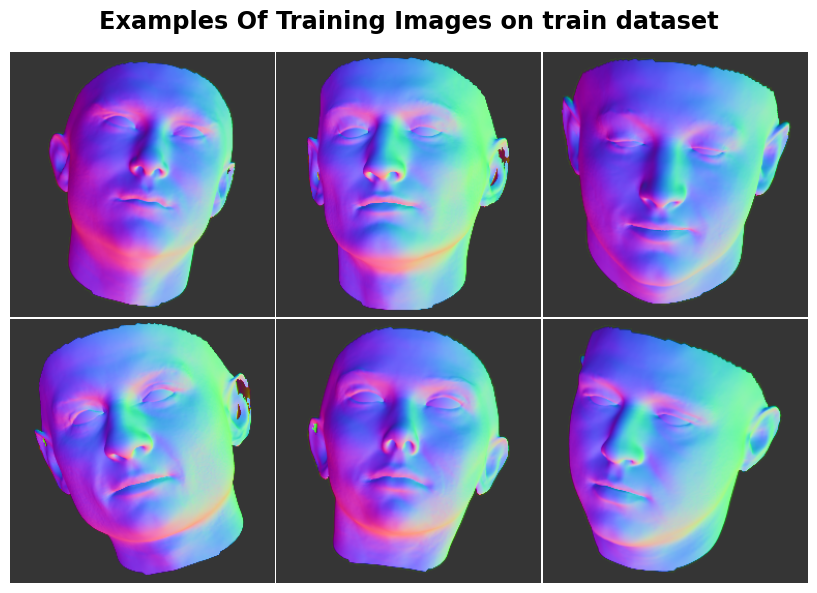

In [4]:
for images in train_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Training Images on train dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Show some images on the test dataset

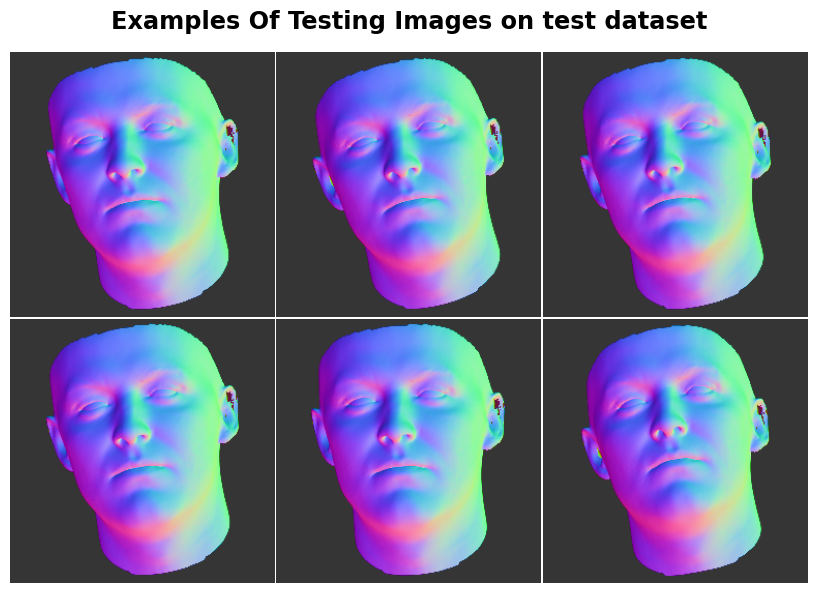

In [5]:
for images in test_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Testing Images on test dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

# Mask Code Set

### Generate Irregular Mask (batch size)

In [6]:
def mask_irregular(batch_size, mask_width, mask_height):
    
    size = int(round((mask_width + mask_height) * 0.03))
    mask = np.zeros((batch_size,mask_width,mask_height,1))
    
    for _ in range(np.random.randint(1, 20)):
        
        x1, x2 = np.random.randint(1, mask_width, batch_size), np.random.randint(1, mask_width, batch_size)
        y1, y2 = np.random.randint(1, mask_height, batch_size), np.random.randint(1, mask_height, batch_size)
        thickness = np.random.randint(1, size, batch_size)
        
        for i in range(batch_size):
            cv2.line(mask[i],(x1[i], y1[i]),(x2[i],y2[i]),(1,1,1), thickness[i])

    return np.float32(((1 - mask)*2) - 1) # [-1, 1]

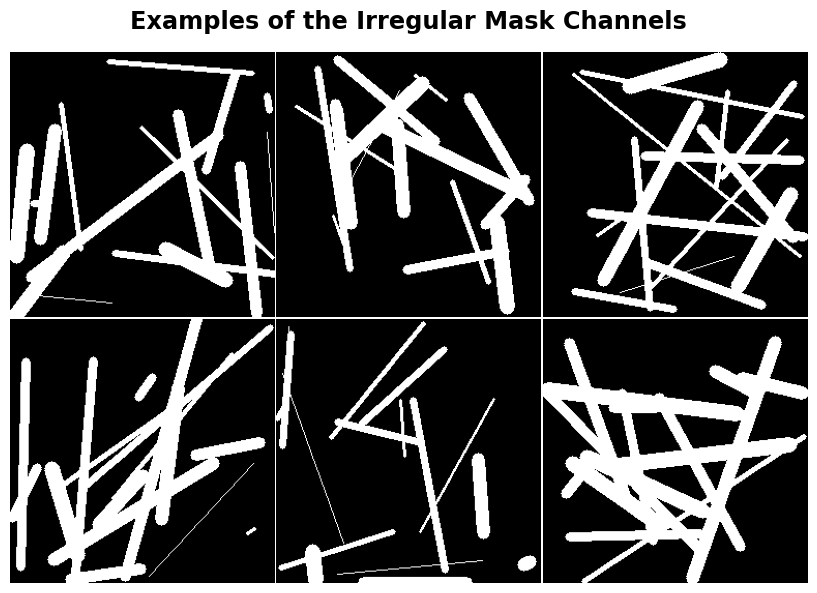

In [7]:
irregular_mask_examples = mask_irregular(6, train_dataset_width, train_dataset_height)

for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the masked imgs (batch size)

In [8]:
def masked_imgs(raw_imgs, mask_channels):
    
    raw_imgs = (raw_imgs + 1.0) / 2.0 # [0, 1]
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    
    # masked_images = np.multiply(raw_imgs, mask_channels)
    masked_images = tf.multiply(raw_imgs, mask_channels)  # 使用 tf.multiply 替代 np.multiply
    
    masked_images = (masked_images * 2.0) - 1.0 # [-1, 1]
    
#     masked_images[:][masked_images[:] == 0] = 1. # Set the white mask
    
    return masked_images

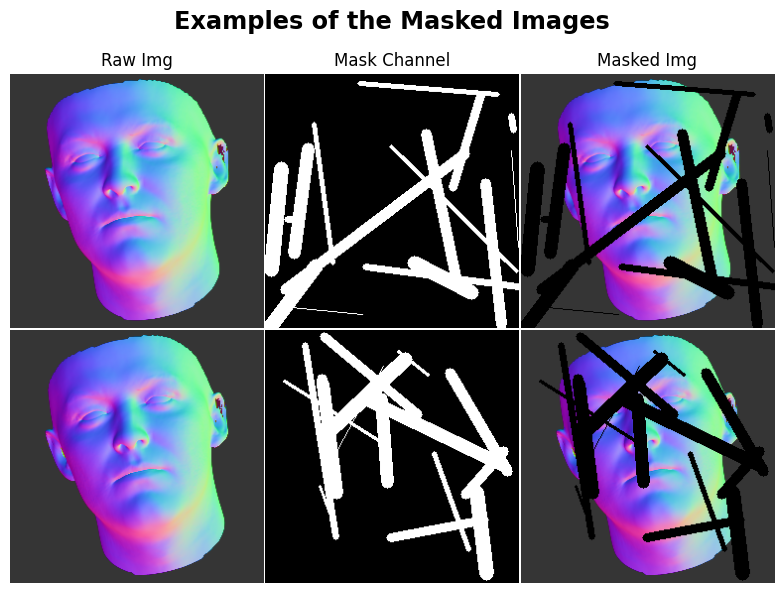

In [9]:
for images_batch in test_dataset.take(1):
    raw_images_examples = images_batch[:2]

irregular_mask_examples = irregular_mask_examples[:2]
masked_images_examples = masked_imgs(raw_images_examples, irregular_mask_examples)

grid = ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3))

for i in range(2):
    ax = grid[i*3]
    ax.imshow((raw_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Raw Img')
    
    ax = grid[i*3+1]
    ax.imshow((irregular_mask_examples[i]+1)/2, cmap='binary')
    ax.axis('off')
    if i == 0:
        ax.set_title('Mask Channel')
    
    ax = grid[i*3+2]
    ax.imshow((masked_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Masked Img')
    
plt.suptitle('Examples of the Masked Images', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the pred only masked region imgs (batch size)

In [10]:
def only_masked_region_pred_imgs(mask_channels, masked_imgs, pred_imgs):
    
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    masked_imgs = (masked_imgs + 1.0) / 2.0 # [0, 1]
    pred_imgs = (pred_imgs + 1.0) / 2.0 # [0, 1]
    
    masked_region_pred_imgs = masked_imgs + pred_imgs * (1.0 - mask_channels)
    
    masked_region_pred_imgs = (masked_region_pred_imgs * 2.0) - 1.0 # [-1, 1]
    
    return masked_region_pred_imgs

# Painting Function

In [11]:
def generator_plot_images(gen_model, text, dataset, num=3, save_path='./saved_images', epoch=0, save_images=False):
    os.makedirs(save_path, exist_ok=True)
    
    for images_batch in dataset.take(1):
        raw_images = images_batch
        mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
        masked_images = masked_imgs(raw_images, mask_channels)
        pred_images = gen_model([masked_images, mask_channels], training=False)
        pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

        masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)
    
    grid = ImageGrid(plt.figure(figsize=(12, num*3)), 111, nrows_ncols=(num, 4))
    
    for i in range(num):
        
        ax = grid[i*4]
        ax.imshow((raw_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Raw {} Img'.format(text))

        ax = grid[i*4+1]
        ax.imshow((masked_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Masked {} Img'.format(text))
            
        ax = grid[i*4+2]
        ax.imshow((pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred {} Img'.format(text))
        
        ax = grid[i*4+3]
        ax.imshow((masked_region_pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred Only Masked Reg. {} Img'.format(text))
        
    plt.tight_layout()
    if save_images:
        image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
        plt.savefig(image_save_path)   
    plt.show()

In [12]:
def plot_loss_metric(train_loss, train_metric, test_loss, test_metric, title, metric, start=0):
    x_values = range(start, start + len(train_loss))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plotting the training set
    ax_train_loss = ax1
    ax_train_metric = ax1.twinx()
    ax_train_loss.plot(x_values, train_loss, color='tab:red')
    ax_train_metric.plot(x_values, train_metric, color='tab:blue')

    ax_train_loss.set_xlabel('Epochs')
    ax_train_loss.set_ylabel('Loss', color='tab:red')
    ax_train_metric.set_ylabel(metric, color='tab:blue')

    ax_train_loss.tick_params(axis='y', labelcolor='tab:red')
    ax_train_metric.tick_params(axis='y', labelcolor='tab:blue')

    ax1.set_title('Train - ' + title)

    # Plotting the test set
    ax_test_loss = ax2
    ax_test_metric = ax2.twinx()
    ax_test_loss.plot(x_values, test_loss, color='tab:green')
    ax_test_metric.plot(x_values, test_metric, color='tab:purple')

    ax_test_loss.set_xlabel('Epochs')
    ax_test_loss.set_ylabel('Loss', color='tab:green')
    ax_test_metric.set_ylabel(metric, color='tab:purple')

    ax_test_loss.tick_params(axis='y', labelcolor='tab:green')
    ax_test_metric.tick_params(axis='y', labelcolor='tab:purple')

    ax2.set_title('Test - ' + title)

    plt.tight_layout()
    plt.show()

# Model Definition Code Set

### Define the loss

In [13]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
# Cosine Similarity
cosine_loss = tf.keras.losses.CosineSimilarity(axis=3)

### Generator (encoder-decoder network)

In [14]:
class UnitNormalize(tf.keras.layers.Layer):
    def __init__(self):
        super(UnitNormalize, self).__init__()

    def call(self, inputs):
        return tf.math.l2_normalize(inputs, axis=2, epsilon=1e-6)

In [15]:
def generator_model():
    
    masked_image = tf.keras.layers.Input(shape=((256, 256, 3)))
    mask = tf.keras.layers.Input(shape=((256, 256, 1)))
    maskedImage_mask = tf.keras.layers.concatenate([masked_image, mask])
    
    # Encoder with skip connections
    skips = []
    
    # Encoder - Input a masked image and mask
    
    # (256, 256, 4) -> (128, 128, 64) 
    x = Conv2D(64, kernel_size=4, strides=2, padding="same")(maskedImage_mask)
    x = LeakyReLU(alpha=0.2)(x)
    skips.append(x)
    
    # (128, 128, 64) -> (64, 64, 128) 
    x = Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (64, 64, 128) -> (32, 32, 256) 
    x = Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (32, 32, 256) -> (16, 16, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (16, 16, 512) -> (8, 8, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (8, 8, 512) -> (4, 4, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (4, 4, 512) -> (2, 2, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)

    # (2, 2, 512) -> (1, 1, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # Decoder
    # Decoder with skip connections
    # Assuming x is the output of the last layer of the encoder
    for skip_layer in reversed(skips[:-1]):  # Not using the last skip connection
        x = Conv2DTranspose(x.shape[-1] // 2, kernel_size=4, strides=2, padding="same")(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = BatchNormalization()(x)
        x = Concatenate()([x, skip_layer])  # skip connection
    
    # Final layer
    # (128, 128, 16) -> (256, 256, 3)
    x = Conv2DTranspose(3, kernel_size=4,strides=2,padding="same")(x)
    
    x = Activation('tanh')(x) # [-1, 1]
    output = UnitNormalize()(x)
    
    model = tf.keras.Model(inputs=[masked_image, mask], outputs=output)

    return model

In [16]:
def generator_loss(fake_output, target_images, generated_images, 
                   lambda_reconstruction = 10, lambda_adversarial=1):
    
    reconstruction_loss = 1 + cosine_loss(target_images, generated_images)
    
    adversarial_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    
    total_loss = lambda_reconstruction * reconstruction_loss + lambda_adversarial * adversarial_loss
    
    return total_loss

In [17]:
def generator_ssim(target_images, generated_images):
    ssim = tf.image.ssim(target_images, generated_images, max_val=2.0)
    ssim = tf.reduce_mean(ssim)
    return ssim

In [18]:
def generator_psnr(target_images, generated_images):
    psnr = tf.image.psnr(target_images, generated_images, max_val=2.0)
    psnr = tf.reduce_mean(psnr)
    return psnr

In [19]:
generator = generator_model()
generator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

### Discriminator

In [20]:
def discriminator_model():
    
    image = tf.keras.layers.Input(shape=(256, 256, 3), name="input_layer")
    
    # (256, 256, 3) -> (128, 128, 32)
    x = Conv2D(32, kernel_size=4, strides=2, padding="same", name="conv1")(image)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (128, 128, 32) -> (64, 64, 64)
    x = Conv2D(64, kernel_size=4, strides=2, padding="same", name="conv2")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # (64, 64, 64) -> (32, 32, 128)
    x = Conv2D(128, kernel_size=4, strides=2, padding="same", name="conv3")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (32, 32, 128) -> (16, 16, 256)
    x = Conv2D(256, kernel_size=4, strides=2, padding="same", name="conv4")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (16, 16, 256) -> (8, 8, 512)
    x = Conv2D(512, kernel_size=4, strides=2, padding="same", name="conv5")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (8, 8, 512) -> (4, 4, 1024)
    x = Conv2D(1024, kernel_size=4, strides=2, padding="same", name="conv6")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (4, 4, 1024) -> (1, 1, 1)
    x = Conv2D(1, kernel_size=4, strides=1, padding="valid", name="conv7")(x)

    x = Flatten()(x)
    
    output = Dense(1, name="dense1")(x)
    output = Activation('sigmoid')(output)
    
    model = tf.keras.Model(inputs=image, outputs=output)
    
    return model

In [21]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [22]:
def discirminator_acc(real_output, fake_output):
    real_acc = tf.reduce_mean(tf.cast(tf.greater(real_output, 0.5), tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(tf.less(fake_output, 0.5), tf.float32))
    total_acc = (real_acc + fake_acc) / 2.0
    return total_acc

In [23]:
discriminator = discriminator_model()
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

# Demonstration of an untrained model

### Use of (untrained) discriminator to classify the generated images as true or false

In [24]:
real_decision = discriminator(raw_images_examples)
pred_images_examples = generator([masked_images_examples, irregular_mask_examples], training=False)
fake_decision = discriminator(pred_images_examples)

print ("Real Images: ",real_decision)
print ("Fake Images: ",fake_decision)
print("Discirminator Loss: ", discriminator_loss(real_decision,fake_decision))
print("Discirminator Accuracy: ", discirminator_acc(real_decision,fake_decision))

Real Images:  tf.Tensor(
[[0.49949685]
 [0.49941072]], shape=(2, 1), dtype=float32)
Fake Images:  tf.Tensor(
[[0.49996948]
 [0.5000116 ]], shape=(2, 1), dtype=float32)
Discirminator Loss:  tf.Tensor(1.3873684, shape=(), dtype=float32)
Discirminator Accuracy:  tf.Tensor(0.25, shape=(), dtype=float32)


### Generate some images using (untrained) generator

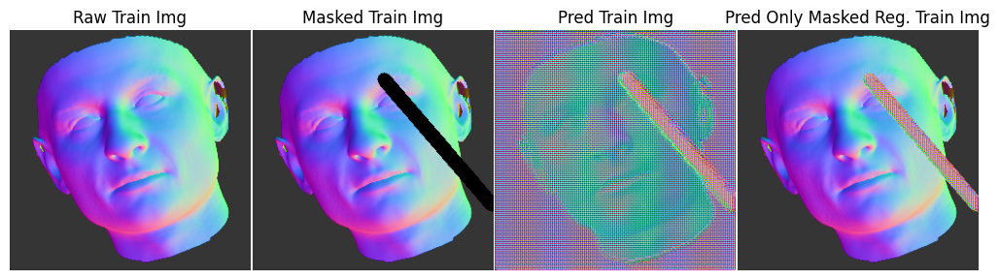

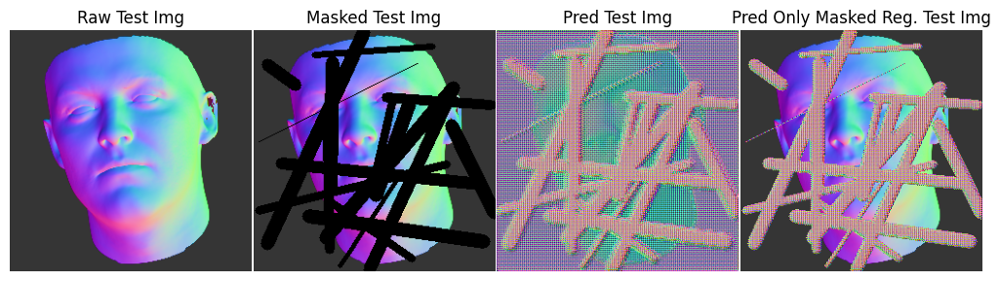

In [25]:
generator_plot_images(generator, 'Train', train_dataset, num = 1)
generator_plot_images(generator, 'Test', test_dataset, num = 1)

In [26]:
print("Generator Loss: ", generator_loss(fake_decision, raw_images_examples,pred_images_examples))
print("Generator SSIM: ", generator_ssim(raw_images_examples,pred_images_examples))
print("Generator PSNR: ", generator_psnr(raw_images_examples,pred_images_examples))

Generator Loss:  tf.Tensor(11.162656, shape=(), dtype=float32)
Generator SSIM:  tf.Tensor(-0.0070499973, shape=(), dtype=float32)
Generator PSNR:  tf.Tensor(10.67836, shape=(), dtype=float32)


# Training Code Set

### Define Generator and Discriminator training steps for a batch

In [27]:
@tf.function
def train_generator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as gen_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=True)
        train_fake_output = discriminator(train_generated_images, training=False)
        gen_loss = generator_loss(train_fake_output, train_raw_images, train_generated_images)
        gen_ssim = generator_ssim(train_raw_images, train_generated_images)
        gen_psnr = generator_psnr(train_raw_images, train_generated_images)
        
    gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    
    return gradients, gen_loss, gen_ssim, gen_psnr

In [28]:
@tf.function
def train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as disc_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=False)
        train_real_output = discriminator(train_raw_images, training=True)
        train_fake_output = discriminator(train_generated_images, training=True)
        
        disc_loss = discriminator_loss(train_real_output, train_fake_output)
        disc_acc = discirminator_acc(train_real_output, train_fake_output)

    gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    return gradients, disc_loss, disc_acc

### Define a function to train a list of batches

In [29]:
def train_batches(batches_list, train_discriminator_first):
    gen_loss_total = 0
    gen_ssim_total = 0
    gen_psnr_total = 0
    disc_loss_total = 0
    disc_acc_total = 0

    # cumulative gradient
    accumulated_gen_gradients = [tf.zeros_like(var) for var in generator.trainable_variables]
    accumulated_disc_gradients = [tf.zeros_like(var) for var in discriminator.trainable_variables]
    
    for batch in batches_list:
        train_raw_images = batch
        train_mask_channels = mask_irregular(train_raw_images.shape[0], train_raw_images.shape[1], train_raw_images.shape[2])
        train_masked_images = masked_imgs(train_raw_images, train_mask_channels)
        
        # Train discriminator
        if train_discriminator_first:
            disc_gradients, disc_loss, disc_acc = train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images)
            for i in range(len(accumulated_disc_gradients)):
                accumulated_disc_gradients[i] += disc_gradients[i]
            disc_loss_total += disc_loss.numpy()
            disc_acc_total += disc_acc.numpy()
            
        # Train generator
        else:
            gen_gradients, gen_loss, gen_ssim, gen_psnr = train_generator_step(train_raw_images, train_mask_channels, train_masked_images)
            for i in range(len(accumulated_gen_gradients)):
                accumulated_gen_gradients[i] += gen_gradients[i]
            gen_loss_total += gen_loss.numpy()
            gen_ssim_total += gen_ssim.numpy()
            gen_psnr_total += gen_psnr.numpy()

    # Applying accumulated gradients
    if train_discriminator_first:
        discriminator_optimizer.apply_gradients(zip(accumulated_disc_gradients, discriminator.trainable_variables))
    else:
        generator_optimizer.apply_gradients(zip(accumulated_gen_gradients, generator.trainable_variables))
    
    num_batches = len(batches_list)
    return (gen_loss_total / num_batches, gen_ssim_total / num_batches, gen_psnr_total / num_batches,
            disc_loss_total / num_batches, disc_acc_total / num_batches)

### Evaluate the function for the dataset

In [30]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_loss(fake_output, raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

### Processing batch data

In [31]:
def process_batches(dataset, batches_list_num, train_discriminator_first):
    train_dataset_batches_list = []
    epoch_metrics = {
        "train_gen_loss": [], "train_gen_ssim": [], "train_gen_psnr": [], 
        "train_disc_loss": [], "train_disc_acc": []
    }

    for i, images_batch in enumerate(dataset):
        train_dataset_batches_list.append(images_batch)
        if (i + 1) % batches_list_num == 0:
            batch_metrics = train_batches(train_dataset_batches_list, train_discriminator_first)
            train_dataset_batches_list = []
            for key, value in zip(epoch_metrics.keys(), batch_metrics):
                epoch_metrics[key].append(value)

    # Check for unprocessed batch
    if train_dataset_batches_list:
        batch_metrics = train_batches(train_dataset_batches_list, train_discriminator_first)
        train_dataset_batches_list = []
        for key, value in zip(epoch_metrics.keys(), batch_metrics):
                epoch_metrics[key].append(value)

    return epoch_metrics

### Record training information to CSV file

In [32]:
def record_training_info(log_file, current_epoch, metrics_lists, elapsed_time):
    with open(log_file, "a", newline='') as file:
        writer = csv.writer(file)
        if os.stat(log_file).st_size == 0:
            writer.writerow(["Epoch"] + list(metrics_lists.keys()) + ["Elapsed Time (Seconds)"])

        writer.writerow([current_epoch] + [sum(metrics) / len(metrics) for metrics in metrics_lists.values()] + [elapsed_time])

### Print training information

In [33]:
def print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time, training_module):
    print(f"Epoch {current_epoch}/{total_epochs}  "
          f"Train[G_Loss:{metrics_lists['train_gen_loss'][-1]:.5f} SSIM:{metrics_lists['train_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['train_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['train_disc_loss'][-1]:.5f} {metrics_lists['train_disc_acc'][-1] * 100:.3f}%]  "
          f"Test[G_Loss:{metrics_lists['test_gen_loss'][-1]:.5f} SSIM:{metrics_lists['test_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['test_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['test_disc_loss'][-1]:.5f} {metrics_lists['test_disc_acc'][-1] * 100:.3f}%] "
          f"- {elapsed_time:.0f}s - Training: {'Discriminator' if training_module else 'Generator'}")

### Charting metrics

In [34]:
def plot_metrics(metrics_lists):
    start_epoch = 1
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_ssim'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_ssim'], 
                     'Generator Loss and SSIM', 'SSIM', start=start_epoch)
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_psnr'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_psnr'], 
                     'Generator Loss and PSNR', 'PSNR', start=start_epoch)
    plot_loss_metric(metrics_lists['train_disc_loss'], metrics_lists['train_disc_acc'], 
                     metrics_lists['test_disc_loss'], metrics_lists['test_disc_acc'], 
                     'Discriminator Loss and Accuracy', 'Accuracy', start=start_epoch)

In [35]:
def load_metrics_from_csv(log_file):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                for key in metrics_lists.keys():
                    metrics_lists[key].append(float(row[key]))

    return metrics_lists

### Save checkpoints

In [36]:
checkpoint_dir = './training_checkpoints'
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=1)

### Restore the latest saved checkpoint (if exist)

In [37]:
checkpoint.restore(checkpoint_manager.latest_checkpoint)

### Restoring Training Logs from Previous Sessions

In [38]:
def display_saved_images(epoch, image_path='./saved_images'):
    train_image_path = os.path.join(image_path, f'Train_epoch_{epoch}.png')
    test_image_path = os.path.join(image_path, f'Test_epoch_{epoch}.png')

    if os.path.exists(train_image_path):
        train_image = mpimg.imread(train_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(train_image)
        plt.axis('off')
        plt.show()

    if os.path.exists(test_image_path):
        test_image = mpimg.imread(test_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(test_image)
        plt.axis('off')
        plt.show()

In [39]:
def load_metrics_until_epoch(log_file, epoch):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                if int(row['Epoch']) <= epoch:
                    for key in metrics_lists.keys():
                        metrics_lists[key].append(float(row[key]))

    return metrics_lists

In [40]:
def read_last_epoch(log_file, total_epochs, epoch_break, training_module):
    last_valid_epoch = 0
    cleaned_data = []

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            rows = list(csv.reader(file))
            header = rows[0]
            data_rows = rows[1:]

            # Find a multiple of the last epoch_break
            for row in reversed(data_rows):
                epoch = int(row[0])
                if epoch % epoch_break == 0:
                    last_valid_epoch = epoch
                    cleaned_data = data_rows[:data_rows.index(row) + 1]
                    break

            #  If a matching epoch is found, rewrite the file
            if cleaned_data:
                with open(log_file, "w", newline='') as file:
                    writer = csv.writer(file)
                    writer.writerow(header)
                    writer.writerows(cleaned_data)

            # Reprint previous training information
            for data in cleaned_data:
                current_epoch = int(data[0])
                elapsed_time = float(data[-1])
                metrics_lists = {
                    'train_gen_loss': [float(data[1])],
                    'train_gen_ssim': [float(data[2])],
                    'train_gen_psnr': [float(data[3])],
                    'train_disc_loss': [float(data[4])],
                    'train_disc_acc': [float(data[5])],
                    'test_gen_loss': [float(data[6])],
                    'test_gen_ssim': [float(data[7])],
                    'test_gen_psnr': [float(data[8])],
                    'test_disc_loss': [float(data[9])],
                    'test_disc_acc': [float(data[10])]
                }
                print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time, training_module)

                if current_epoch % epoch_break == 0:
                    display_saved_images(current_epoch)
                    plot_metrics(load_metrics_until_epoch(log_file, current_epoch))

    return last_valid_epoch

### Training

In [41]:
def train(train_dataset, max_epochs, epoch_break, batches_list_num, early_stopping_rounds):
    
    log_dir = './saved_logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, "GAN_training_results.csv")
    
    # Read the last completed epoch
    start_epoch = read_last_epoch(log_file, max_epochs, epoch_break, True)
    
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    best_test_disc_loss = float('inf')
    best_test_gen_loss = float('inf')
    no_improvement_rounds = 0
    train_discriminator_first = True
    generator_first_epoch = True
    EPSILON = 1e-10
        
    for epoch in range(start_epoch, max_epochs):
        start_time = time.time()

        # # For Train
        epoch_metrics = process_batches(train_dataset, batches_list_num, train_discriminator_first)
        for key in epoch_metrics.keys():
            metrics_lists[key].append(sum(epoch_metrics[key]) / len(epoch_metrics[key]))
                    
        # For Test
        test_metrics = assessment(test_dataset)
        for key, value in test_metrics.items():
            metrics_lists['test_' + key].append(value)
        
        # Save Training Information
        current_epoch = epoch + 1
        elapsed_time = time.time() - start_time
        record_training_info(log_file, current_epoch, metrics_lists, elapsed_time)



        # Early stopping check for current training
        if train_discriminator_first:
            current_disc_loss = metrics_lists['test_disc_loss'][-1]
            # Check for discriminator improvements
            if current_disc_loss < best_test_disc_loss and current_disc_loss > EPSILON:
                best_test_disc_loss = current_disc_loss
                no_improvement_rounds = 0
            else:
                no_improvement_rounds += 1

            # Toggle the training order if no improvement
            if no_improvement_rounds >= early_stopping_rounds:
                train_discriminator_first = not train_discriminator_first
                no_improvement_rounds = 0
                generator_training_rounds_without_improvement = 0  # Reset the counter for generator
                generator_first_epoch = True  # Reset the first epoch flag of generator training
        else:
            # Check for generator improvements
            current_gen_loss = metrics_lists['test_gen_loss'][-1]
            if current_gen_loss < best_test_gen_loss and current_gen_loss > EPSILON:
                best_test_gen_loss = current_gen_loss
                no_improvement_rounds = 0
                generator_first_epoch = False
            else:
                no_improvement_rounds += 1

            # If it is the first 10 epochs of generator training and consecutively unimproved, stop training
            if generator_first_epoch and no_improvement_rounds >= early_stopping_rounds:
                print(f"No improvement in generator loss for first {early_stopping_rounds} trainings, stopping training.")
                break
            
            if no_improvement_rounds >= early_stopping_rounds:
                train_discriminator_first = not train_discriminator_first
                no_improvement_rounds = 0
            


    
         # Print Training Information
        print_training_info(current_epoch, max_epochs, metrics_lists, elapsed_time, train_discriminator_first)
        
        # Epoch output results with set intervals
        if (epoch + 1) % epoch_break == 0:
    
            print('Saving checkpoint...')
            checkpoint_manager.save()
            print('Save completed')
            
            generator_plot_images(generator, 'Train', train_dataset, epoch=current_epoch, save_images=True)
            generator_plot_images(generator, 'Test', test_dataset, epoch=current_epoch, save_images=True)

            plot_metrics(load_metrics_from_csv(log_file))

Epoch 1/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.47053 91.815%]  Test[G_Loss:11.14719 SSIM:-0.83% PSNR:10.68 Disc:1.05433 100.000%] - 22s - Training: Discriminator
Epoch 2/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.02314 100.000%]  Test[G_Loss:11.48803 SSIM:-0.81% PSNR:10.68 Disc:0.44969 100.000%] - 3s - Training: Discriminator
Epoch 3/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00961 100.000%]  Test[G_Loss:11.79107 SSIM:-0.70% PSNR:10.68 Disc:0.28904 100.000%] - 3s - Training: Discriminator
Epoch 4/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00603 100.000%]  Test[G_Loss:12.03575 SSIM:-0.72% PSNR:10.68 Disc:0.21661 100.000%] - 3s - Training: Discriminator
Epoch 5/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00447 100.000%]  Test[G_Loss:12.17213 SSIM:-0.72% PSNR:10.68 Disc:0.19546 100.000%] - 3s - Training: Discriminator
Epoch 6/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00357 100.000%]  Test[G_Loss:12.31961 SSIM:-0.7

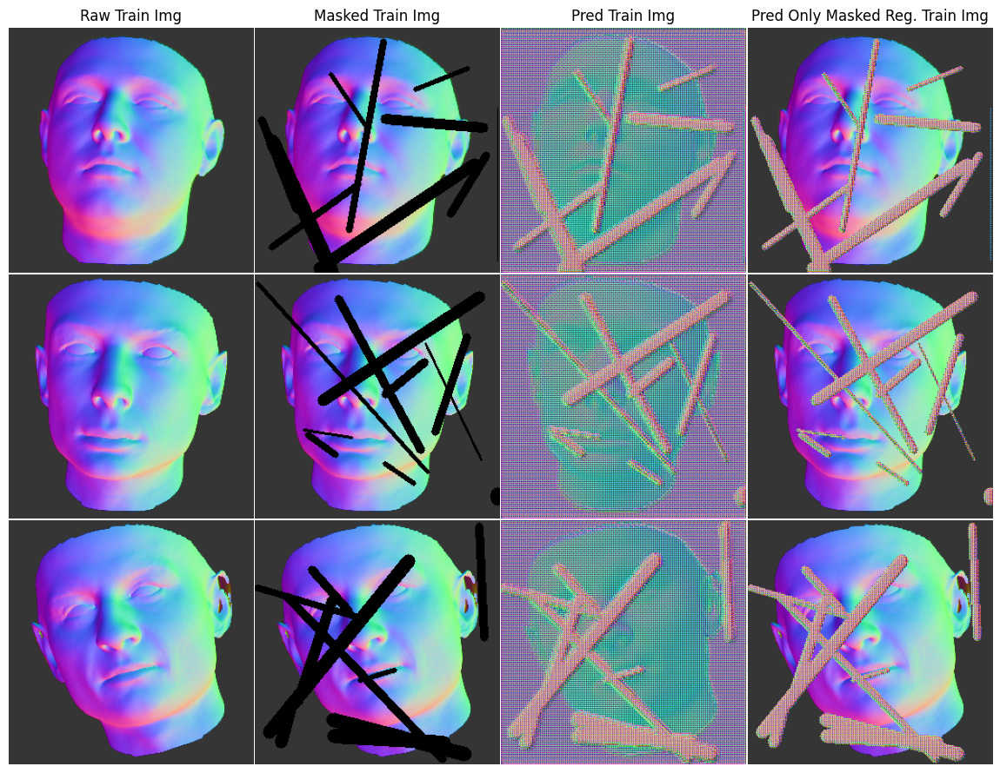

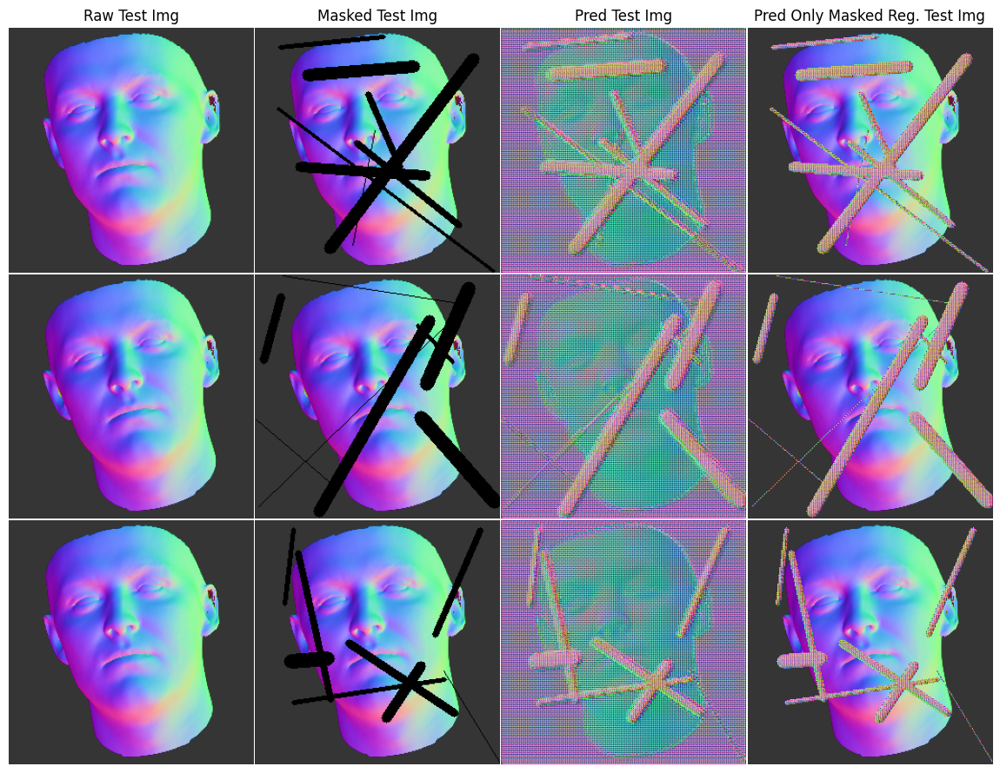

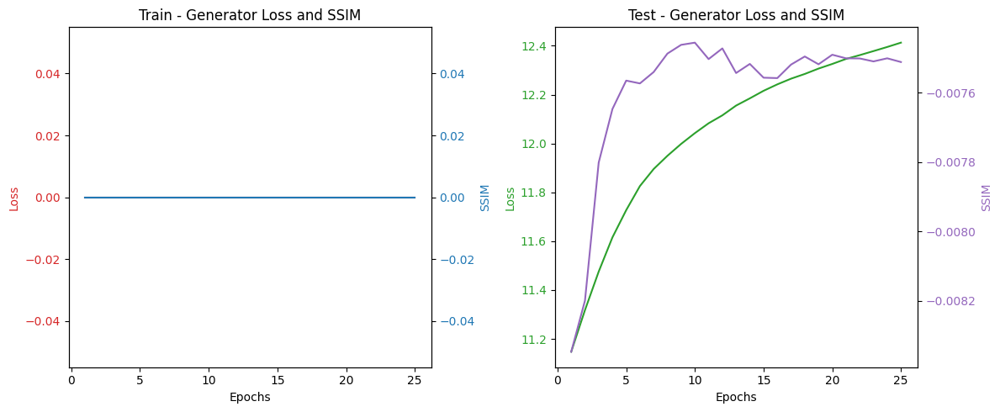

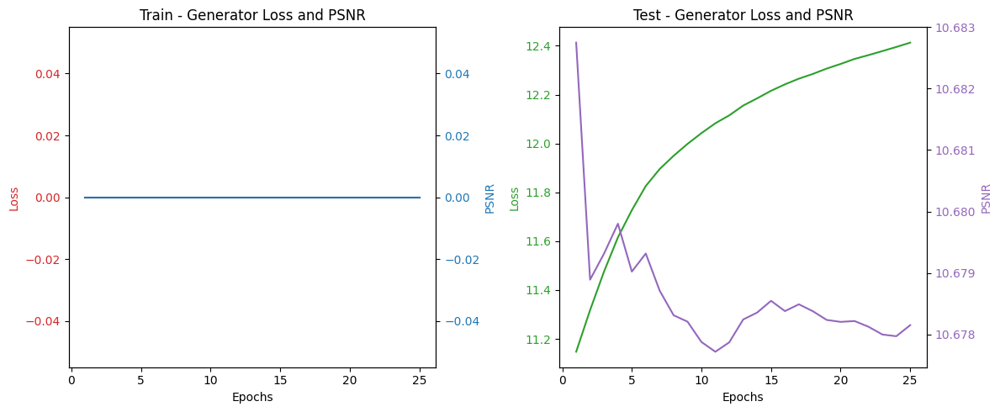

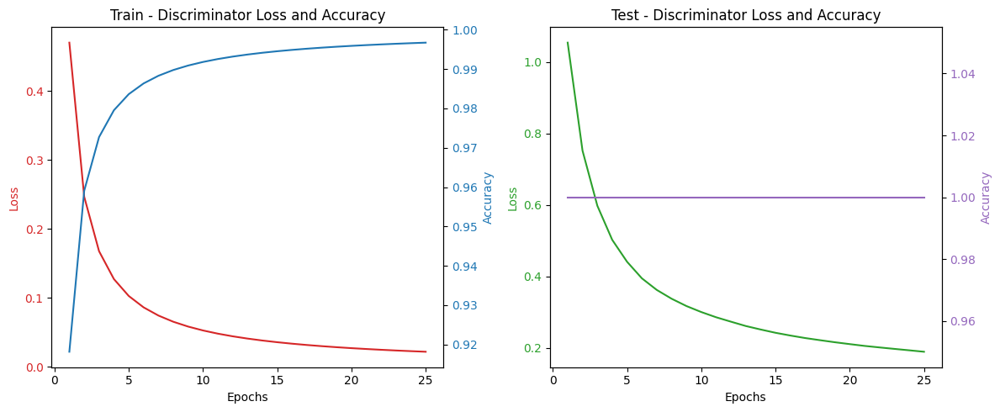

Epoch 26/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00073 100.000%]  Test[G_Loss:12.77115 SSIM:-0.66% PSNR:10.68 Disc:0.10140 100.000%] - 3s - Training: Discriminator
Epoch 27/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00071 100.000%]  Test[G_Loss:12.79424 SSIM:-0.70% PSNR:10.68 Disc:0.09992 100.000%] - 3s - Training: Discriminator
Epoch 28/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00070 100.000%]  Test[G_Loss:12.86957 SSIM:-0.79% PSNR:10.68 Disc:0.09363 100.000%] - 3s - Training: Discriminator
Epoch 29/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00067 100.000%]  Test[G_Loss:12.88405 SSIM:-0.76% PSNR:10.68 Disc:0.08998 100.000%] - 3s - Training: Discriminator
Epoch 30/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00065 100.000%]  Test[G_Loss:12.85497 SSIM:-0.71% PSNR:10.68 Disc:0.09463 100.000%] - 3s - Training: Discriminator
Epoch 31/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00063 100.000%]  Test[G_Loss:12.86856 SSI

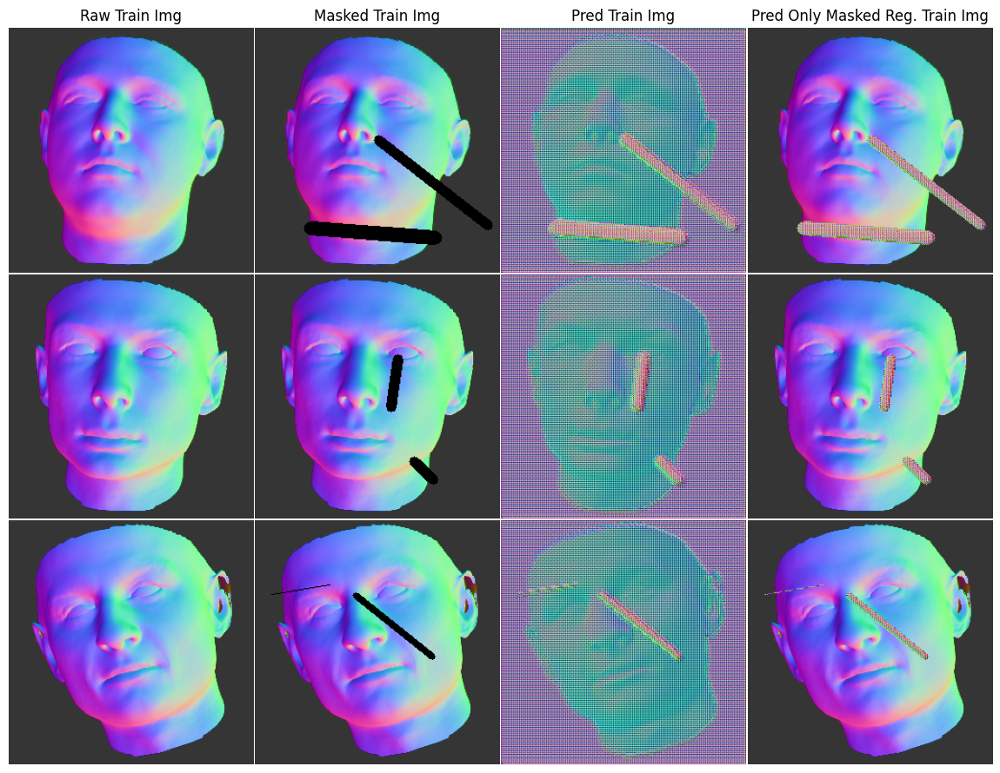

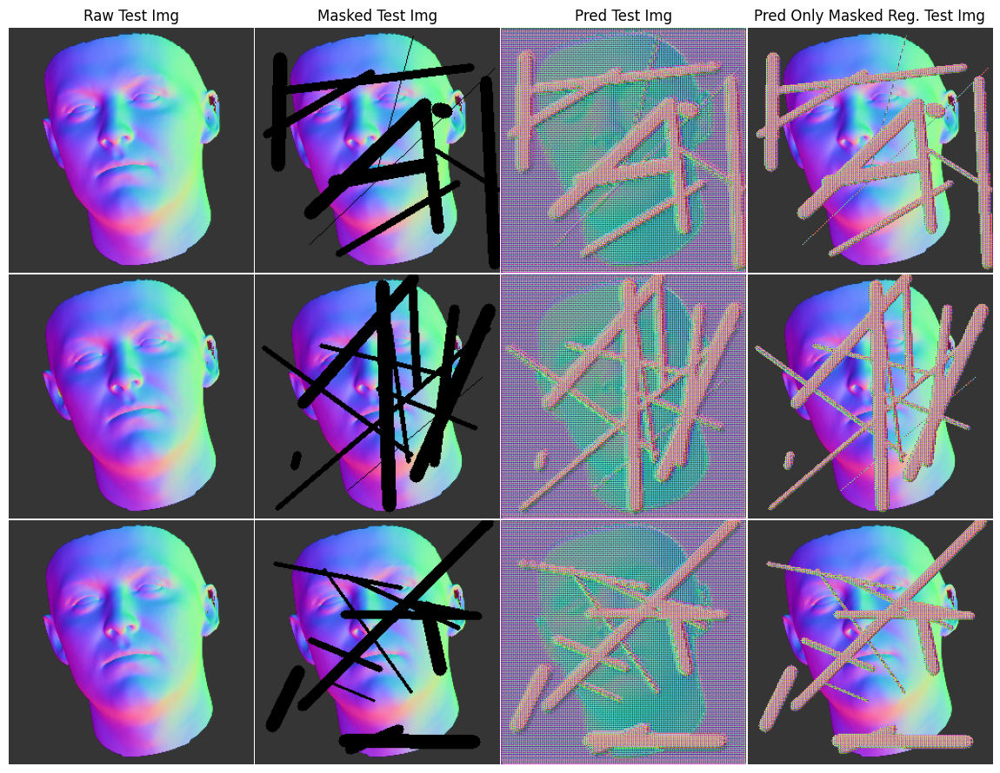

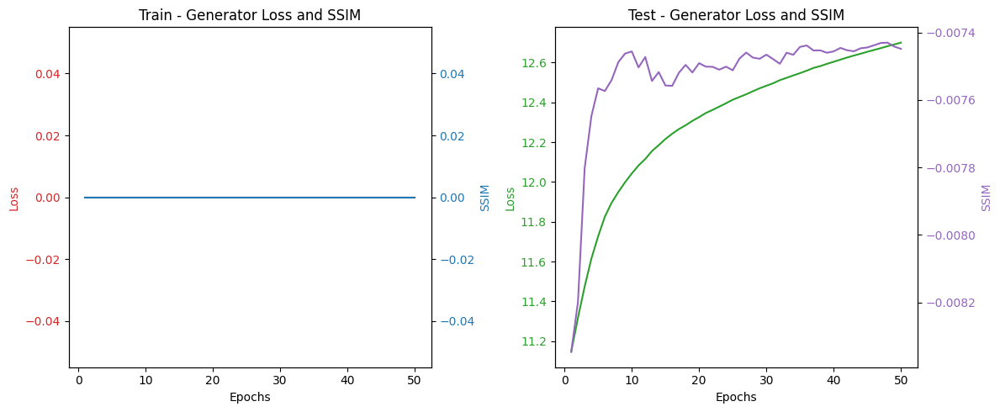

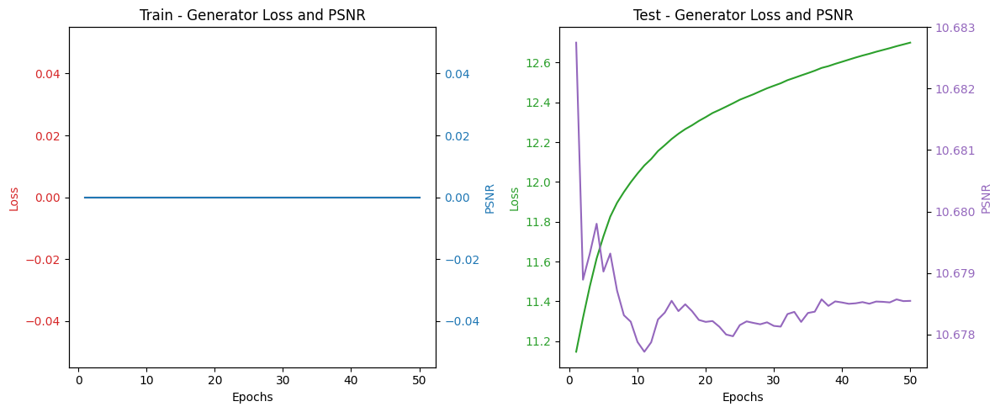

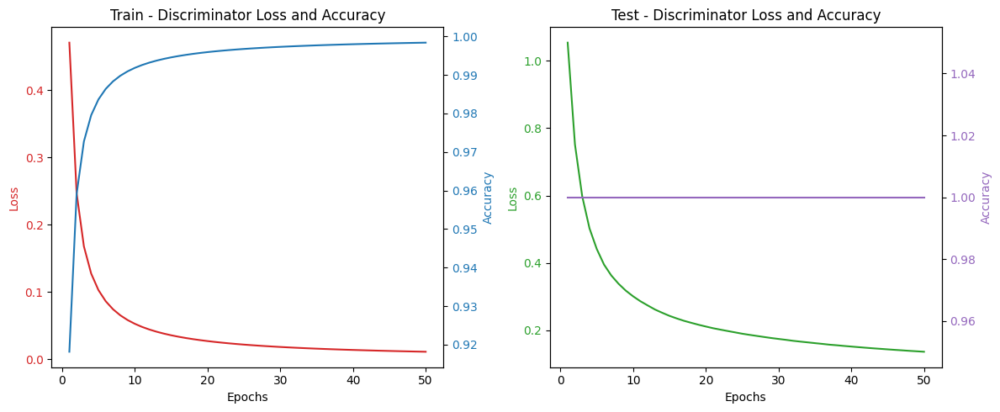

Epoch 51/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00034 100.000%]  Test[G_Loss:13.19103 SSIM:-0.80% PSNR:10.68 Disc:0.06643 100.000%] - 3s - Training: Discriminator
Epoch 52/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00034 100.000%]  Test[G_Loss:13.12381 SSIM:-0.72% PSNR:10.68 Disc:0.07223 100.000%] - 3s - Training: Discriminator
Epoch 53/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00032 100.000%]  Test[G_Loss:13.23225 SSIM:-0.78% PSNR:10.68 Disc:0.06348 100.000%] - 3s - Training: Discriminator
Epoch 54/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00031 100.000%]  Test[G_Loss:13.14467 SSIM:-0.77% PSNR:10.67 Disc:0.07183 100.000%] - 3s - Training: Discriminator
Epoch 55/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00031 100.000%]  Test[G_Loss:13.21902 SSIM:-0.82% PSNR:10.68 Disc:0.06464 100.000%] - 3s - Training: Discriminator
Epoch 56/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00029 100.000%]  Test[G_Loss:13.21089 SSI

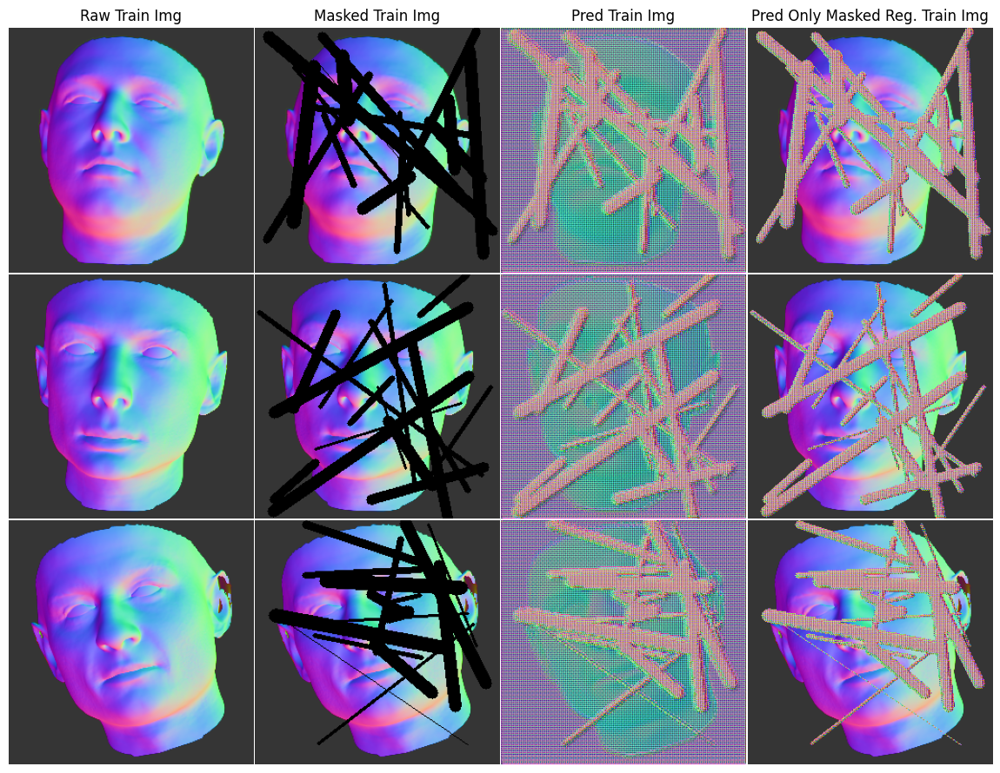

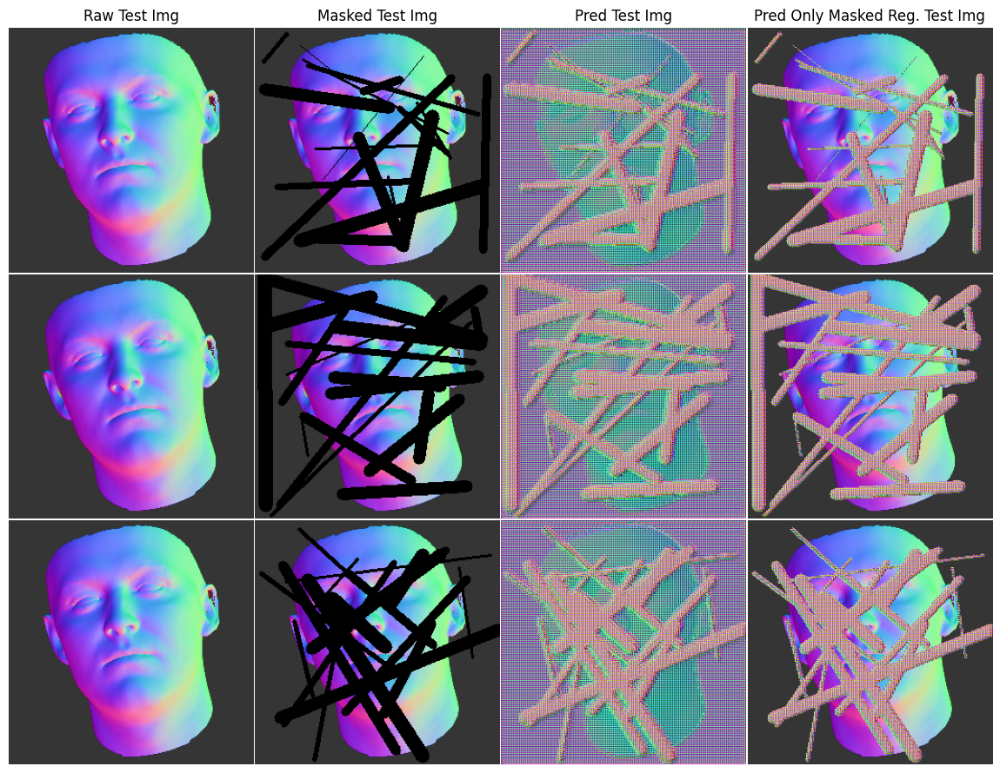

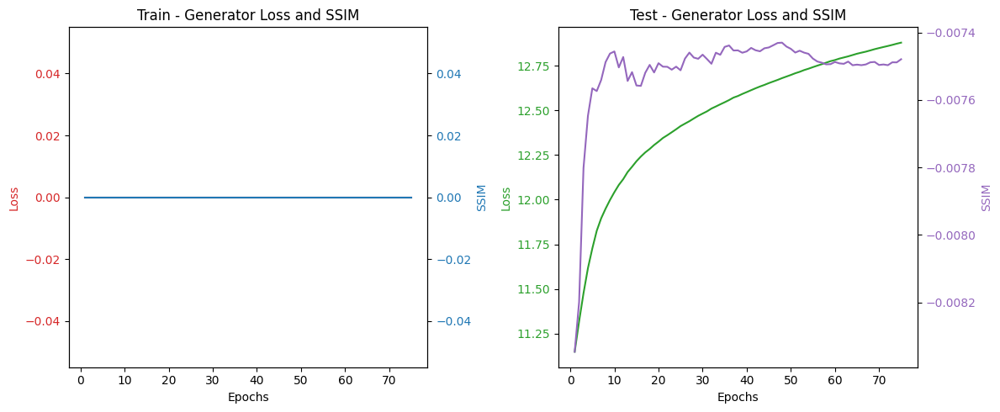

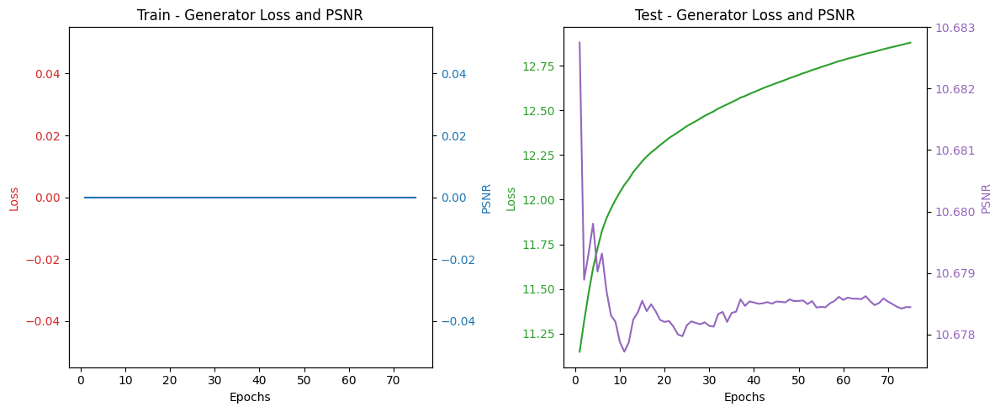

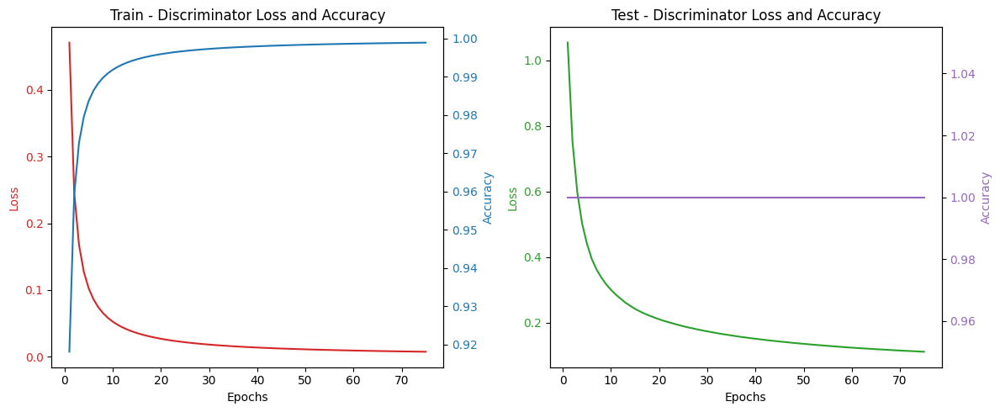

Epoch 76/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00019 100.000%]  Test[G_Loss:13.40748 SSIM:-0.73% PSNR:10.68 Disc:0.05114 100.000%] - 3s - Training: Discriminator
Epoch 77/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00019 100.000%]  Test[G_Loss:13.42954 SSIM:-0.79% PSNR:10.68 Disc:0.05109 100.000%] - 3s - Training: Discriminator
Epoch 78/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00019 100.000%]  Test[G_Loss:13.46162 SSIM:-0.81% PSNR:10.68 Disc:0.04926 100.000%] - 3s - Training: Discriminator
Epoch 79/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00019 100.000%]  Test[G_Loss:13.34831 SSIM:-0.75% PSNR:10.68 Disc:0.05732 100.000%] - 3s - Training: Discriminator
Epoch 80/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00018 100.000%]  Test[G_Loss:13.37845 SSIM:-0.72% PSNR:10.68 Disc:0.05471 100.000%] - 3s - Training: Discriminator
Epoch 81/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00017 100.000%]  Test[G_Loss:13.32070 SSI

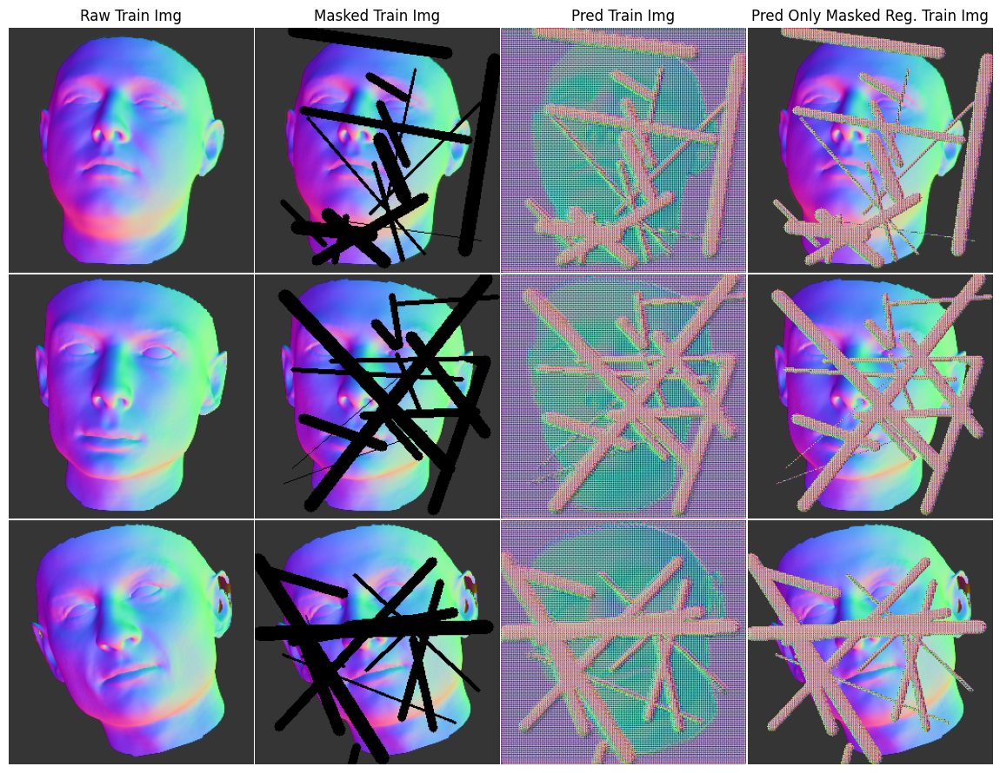

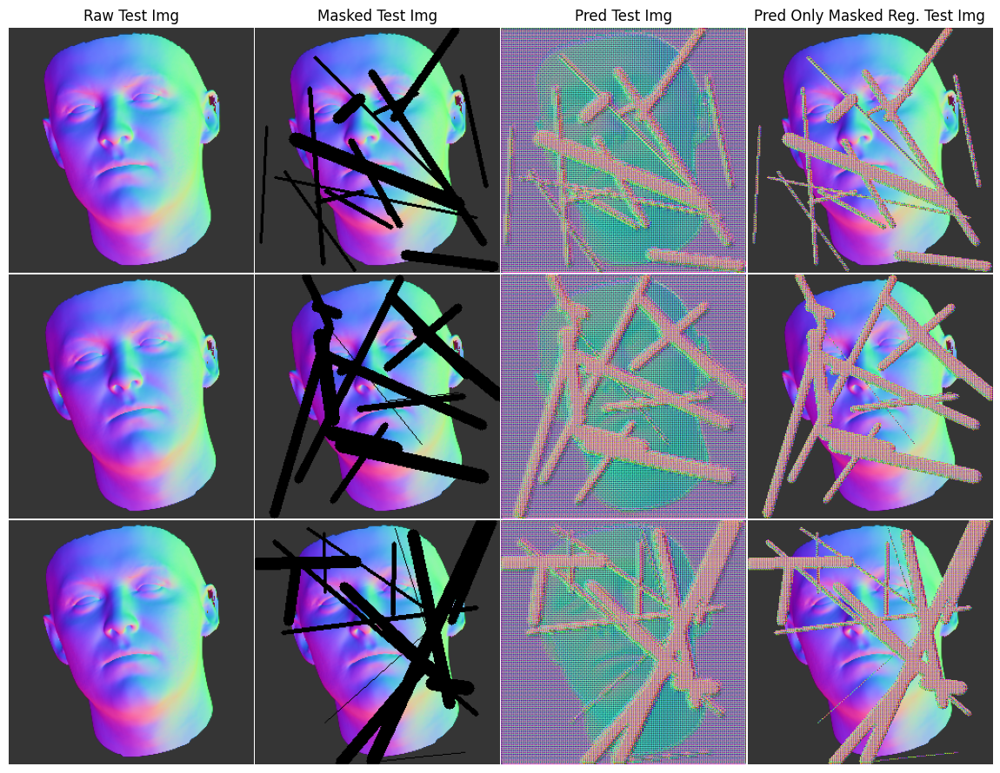

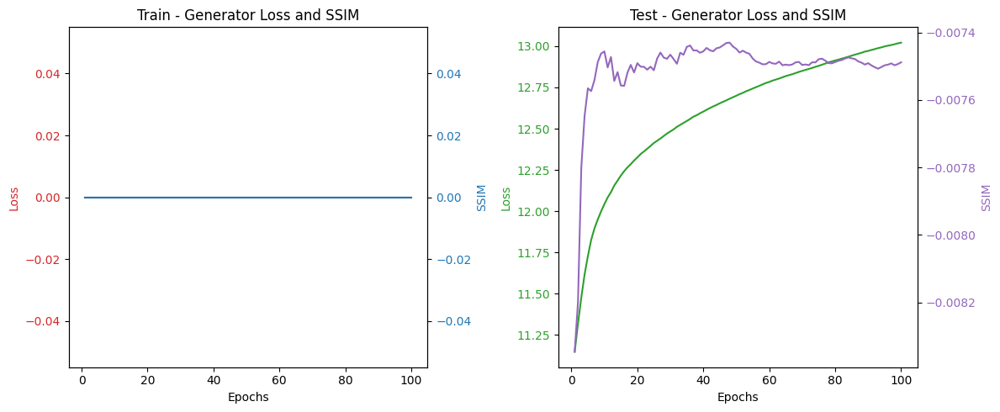

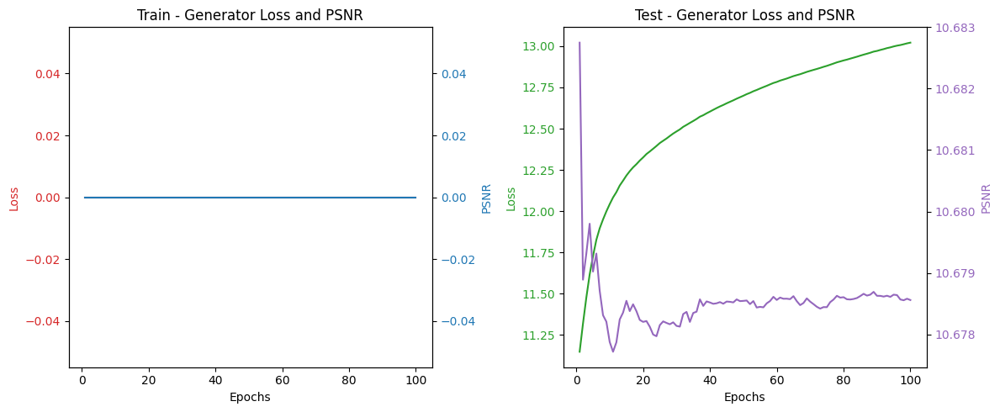

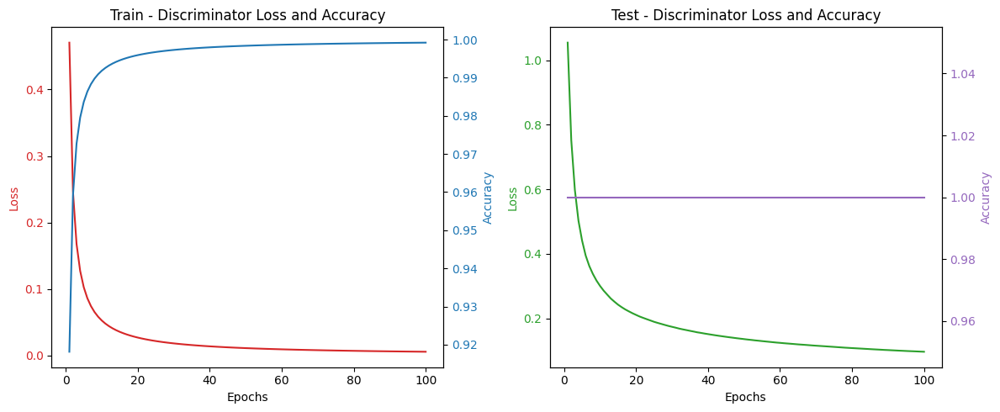

Epoch 101/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00013 100.000%]  Test[G_Loss:13.45448 SSIM:-0.74% PSNR:10.68 Disc:0.05080 100.000%] - 3s - Training: Discriminator
Epoch 102/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00013 100.000%]  Test[G_Loss:13.62026 SSIM:-0.79% PSNR:10.68 Disc:0.04225 100.000%] - 3s - Training: Discriminator
Epoch 103/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00012 100.000%]  Test[G_Loss:13.53291 SSIM:-0.76% PSNR:10.68 Disc:0.04735 100.000%] - 3s - Training: Discriminator
Epoch 104/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00012 100.000%]  Test[G_Loss:13.53210 SSIM:-0.78% PSNR:10.68 Disc:0.04726 100.000%] - 3s - Training: Discriminator
Epoch 105/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00012 100.000%]  Test[G_Loss:13.49352 SSIM:-0.79% PSNR:10.68 Disc:0.04962 100.000%] - 3s - Training: Discriminator
Epoch 106/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00012 100.000%]  Test[G_Loss:13.643

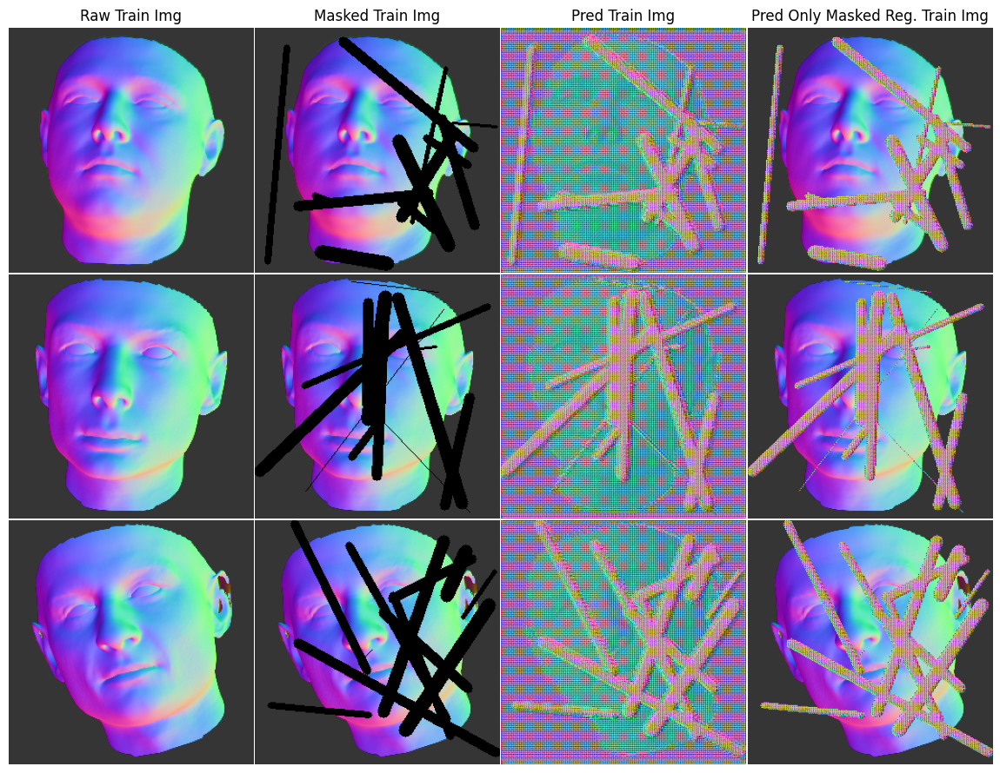

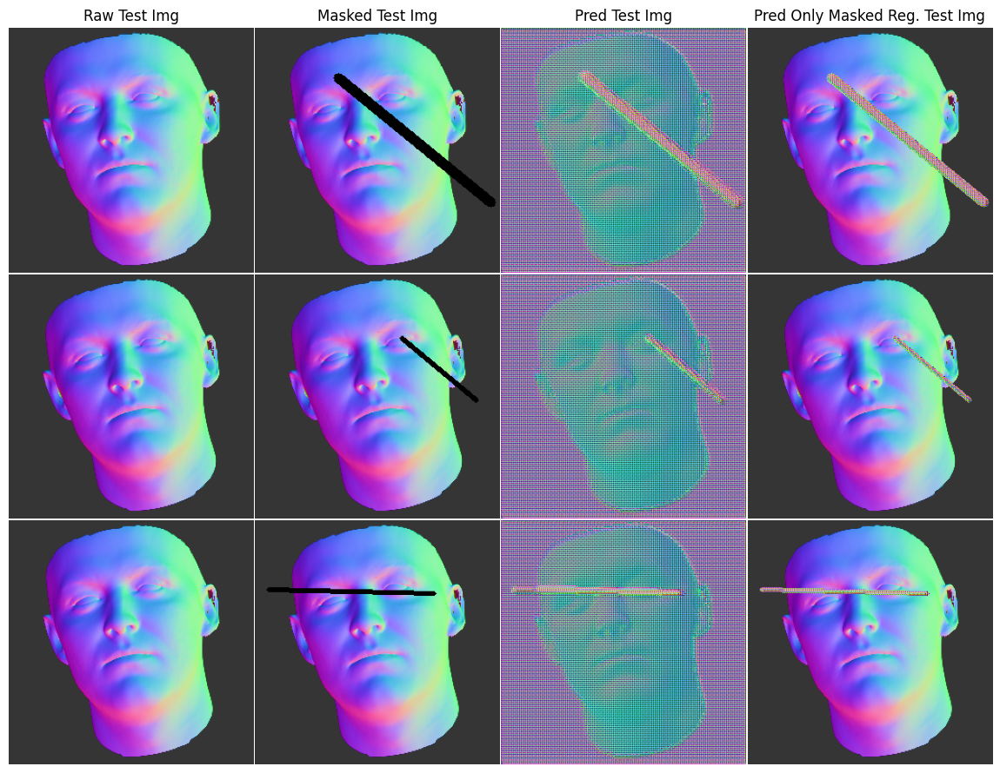

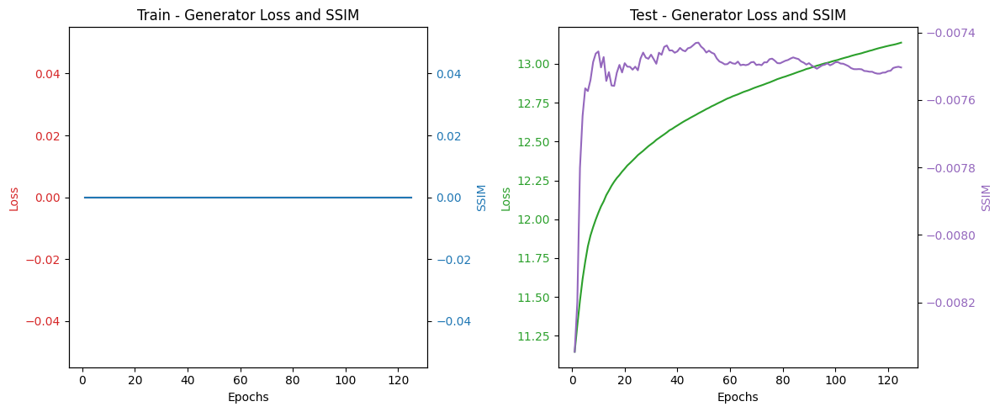

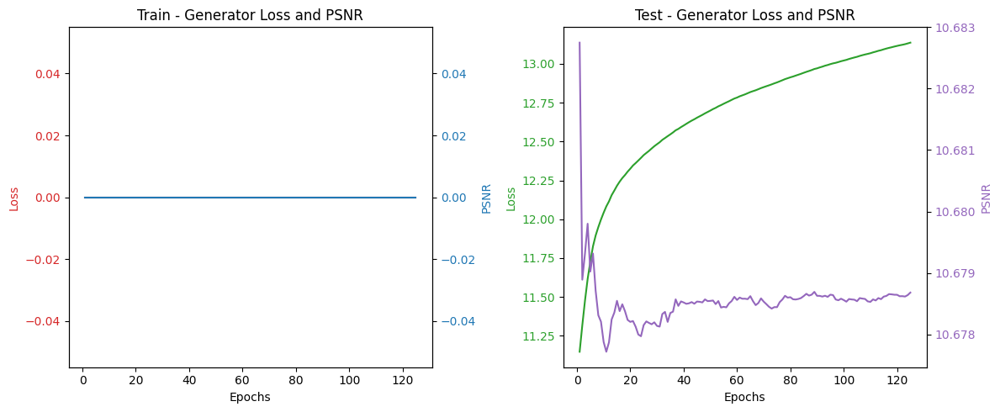

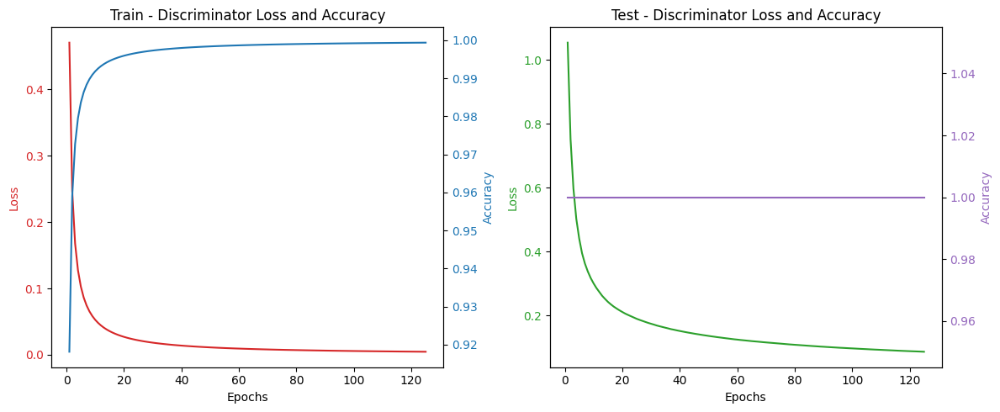

Epoch 126/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00009 100.000%]  Test[G_Loss:13.73863 SSIM:-0.74% PSNR:10.68 Disc:0.03701 100.000%] - 3s - Training: Discriminator
Epoch 127/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00009 100.000%]  Test[G_Loss:13.80856 SSIM:-0.74% PSNR:10.69 Disc:0.03335 100.000%] - 3s - Training: Discriminator
Epoch 128/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00009 100.000%]  Test[G_Loss:13.56255 SSIM:-0.68% PSNR:10.67 Disc:0.04594 100.000%] - 3s - Training: Discriminator
Epoch 129/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00009 100.000%]  Test[G_Loss:13.66754 SSIM:-0.78% PSNR:10.68 Disc:0.04095 100.000%] - 3s - Training: Discriminator
Epoch 130/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00008 100.000%]  Test[G_Loss:13.69794 SSIM:-0.71% PSNR:10.68 Disc:0.03979 100.000%] - 3s - Training: Discriminator
Epoch 131/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00009 100.000%]  Test[G_Loss:13.742

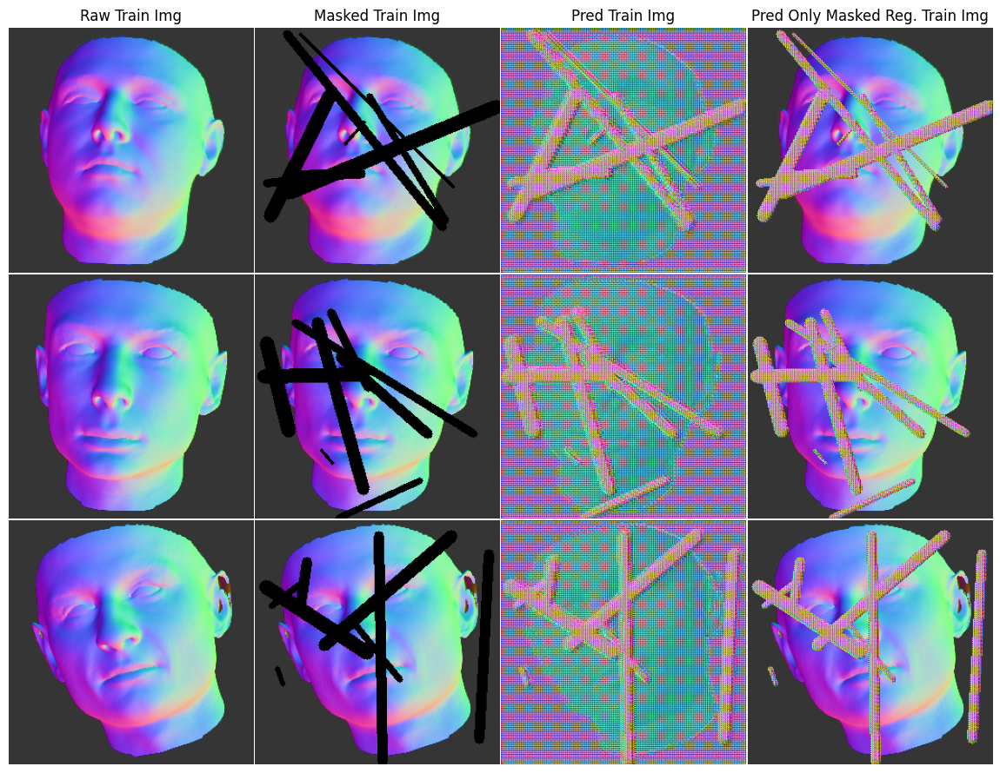

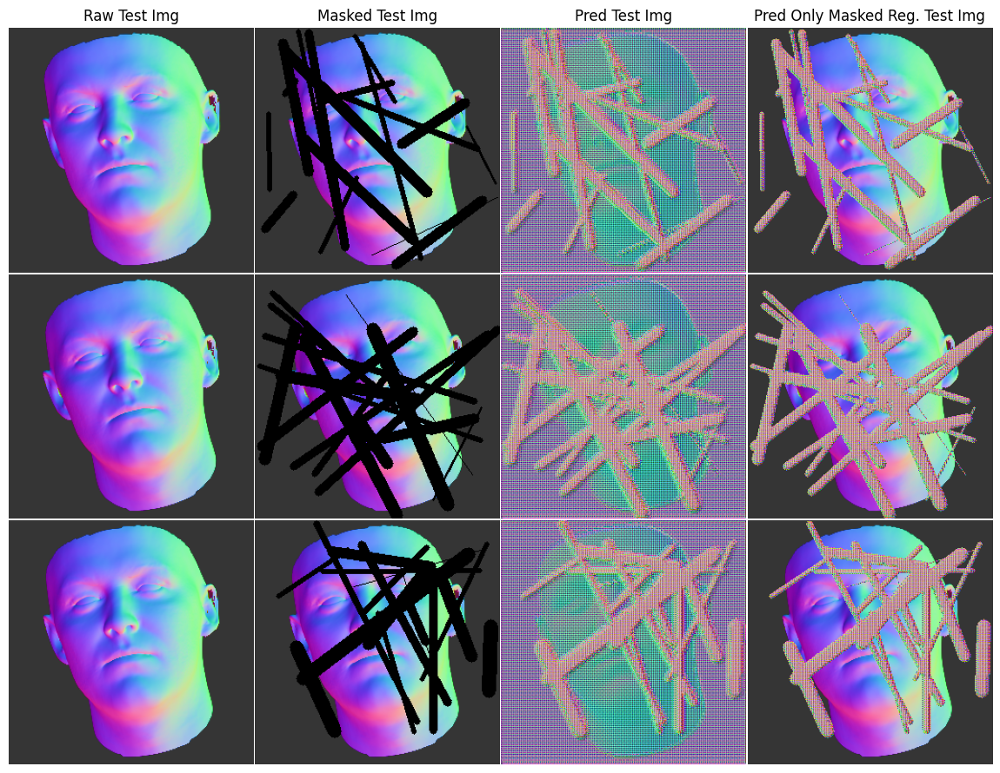

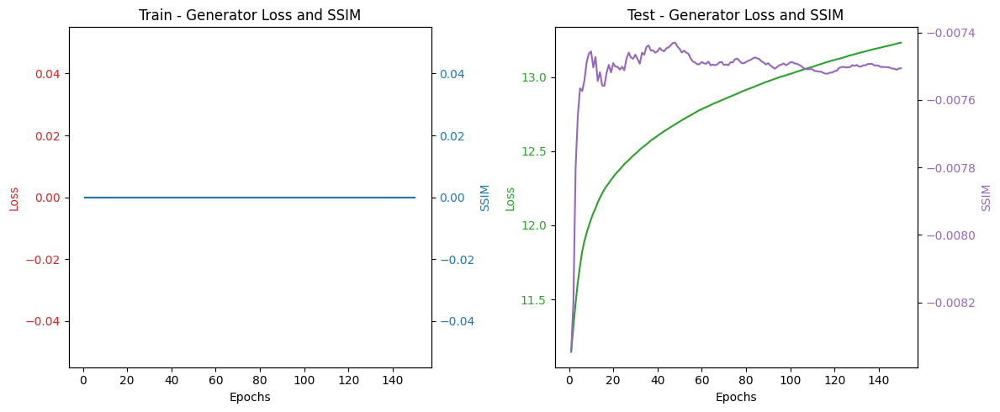

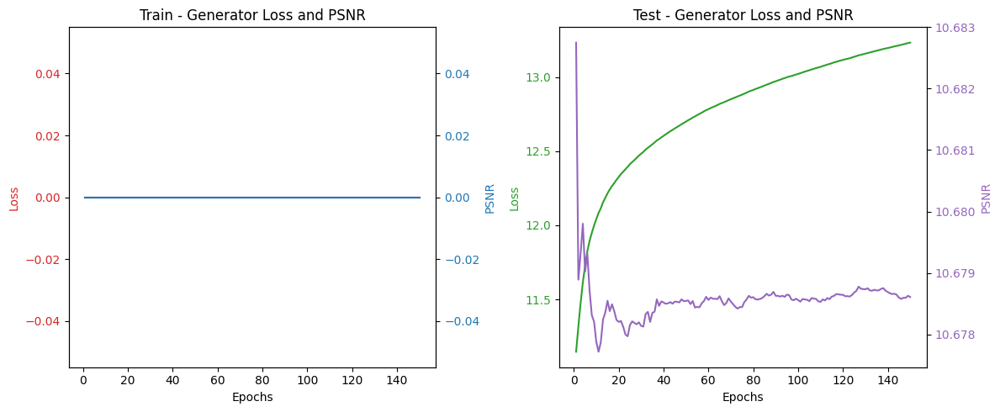

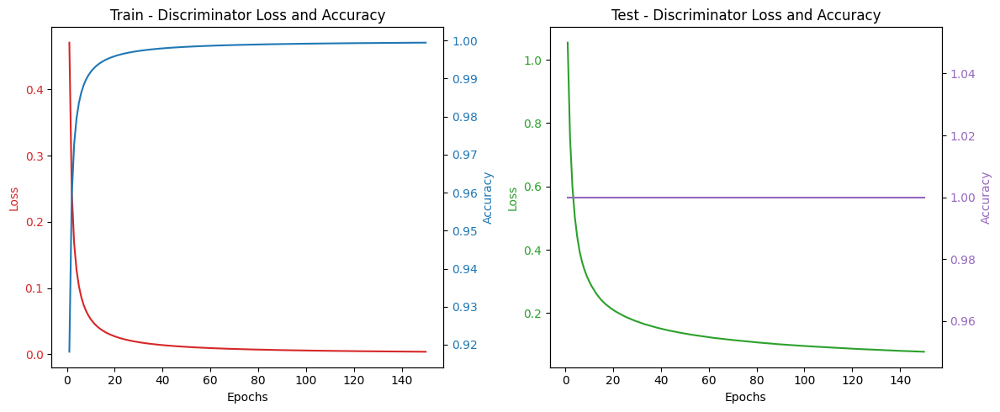

Epoch 151/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00007 100.000%]  Test[G_Loss:13.78240 SSIM:-0.75% PSNR:10.68 Disc:0.03621 100.000%] - 3s - Training: Discriminator
Epoch 152/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00007 100.000%]  Test[G_Loss:13.76259 SSIM:-0.72% PSNR:10.68 Disc:0.03757 100.000%] - 3s - Training: Generator
Epoch 153/2000  Train[G_Loss:5.39630 SSIM:7.96% PSNR:11.27 Disc:0.00000 0.000%]  Test[G_Loss:9.10965 SSIM:6.88% PSNR:11.06 Disc:0.21060 100.000%] - 9s - Training: Generator
Epoch 154/2000  Train[G_Loss:1.84734 SSIM:14.46% PSNR:11.59 Disc:0.00000 0.000%]  Test[G_Loss:8.73321 SSIM:7.05% PSNR:11.07 Disc:0.24367 100.000%] - 6s - Training: Generator
Epoch 155/2000  Train[G_Loss:1.39380 SSIM:16.35% PSNR:11.64 Disc:0.00000 0.000%]  Test[G_Loss:7.73189 SSIM:8.20% PSNR:11.14 Disc:0.35497 100.000%] - 6s - Training: Generator
Epoch 156/2000  Train[G_Loss:1.19651 SSIM:17.00% PSNR:11.66 Disc:0.00000 0.000%]  Test[G_Loss:4.09015 SSIM:11.62% PSNR:11.4

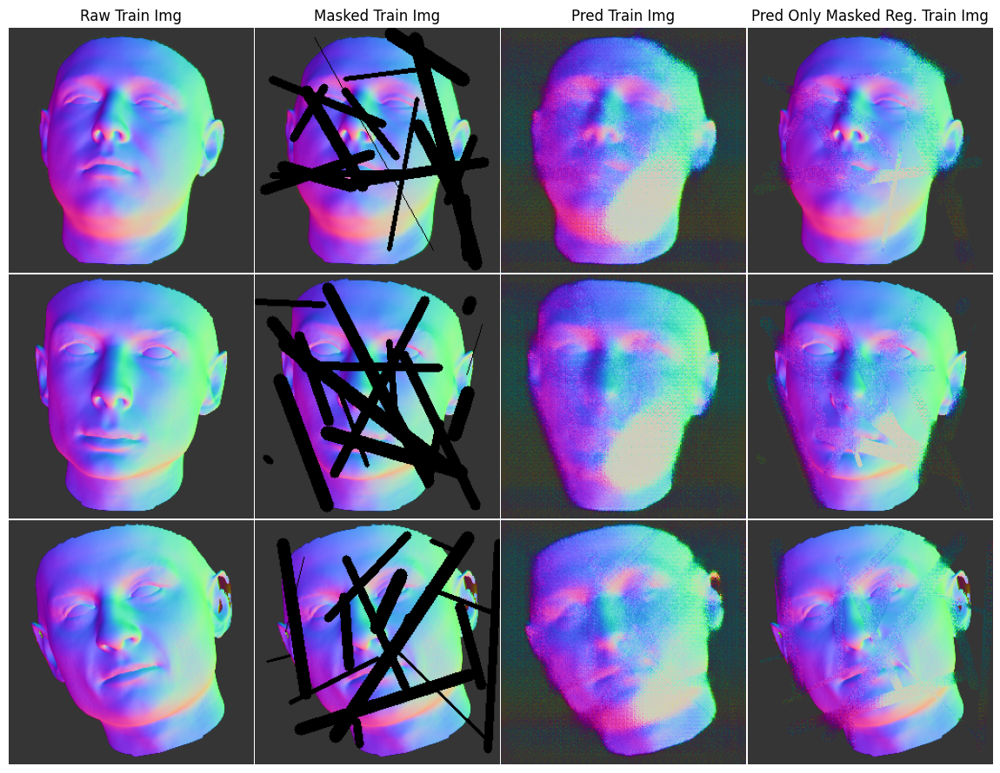

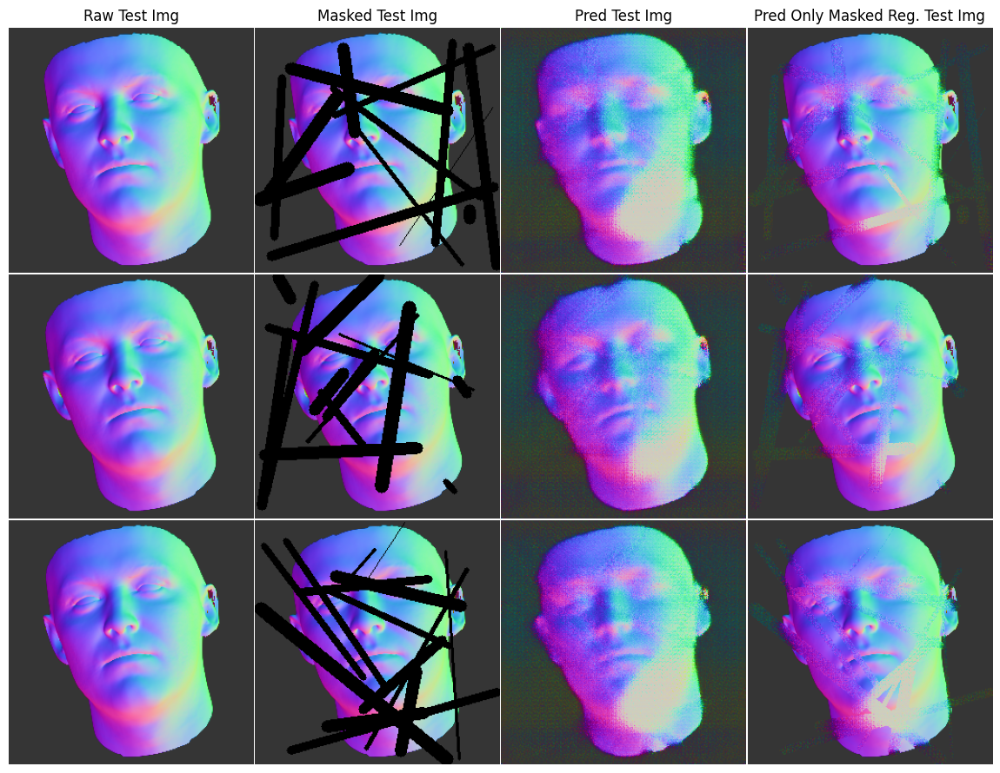

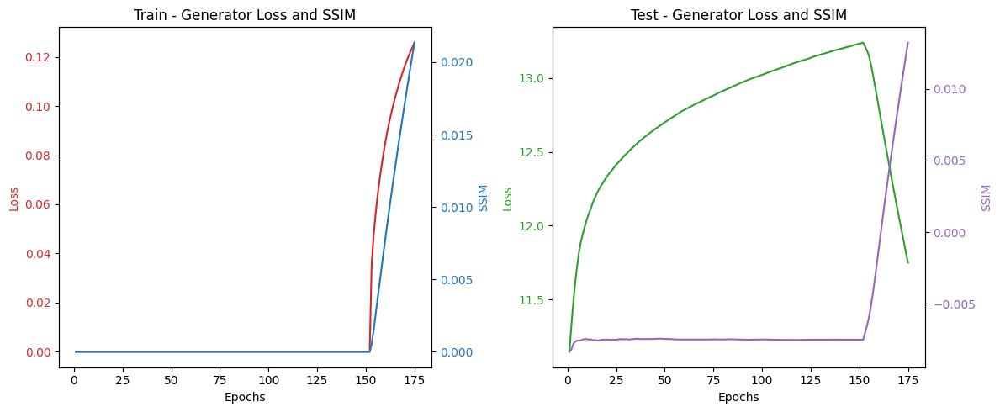

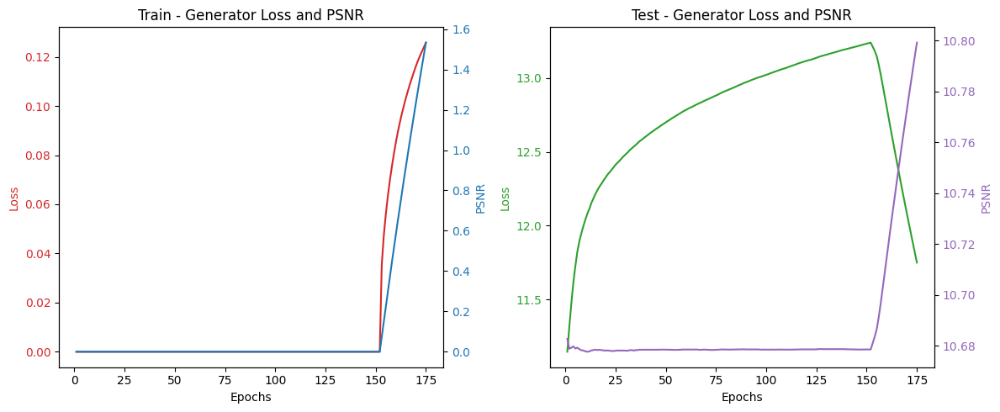

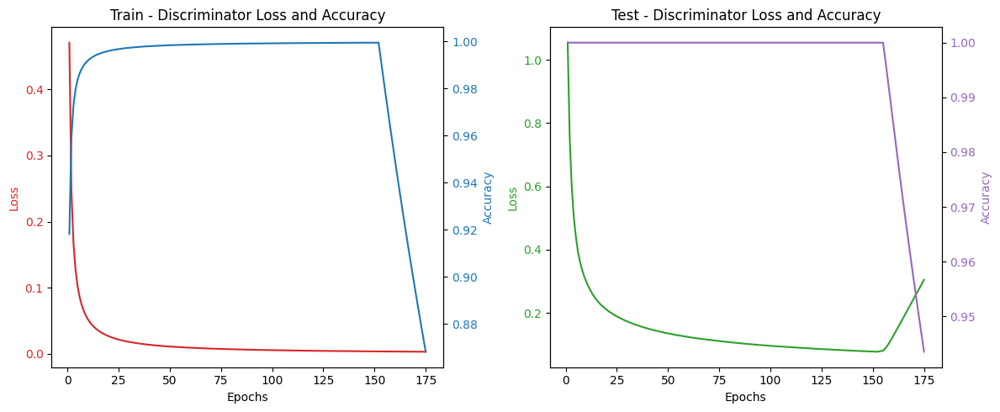

Epoch 176/2000  Train[G_Loss:0.41423 SSIM:16.26% PSNR:11.69 Disc:0.00000 0.000%]  Test[G_Loss:0.40220 SSIM:16.32% PSNR:11.70 Disc:2.37638 50.000%] - 6s - Training: Generator
Epoch 177/2000  Train[G_Loss:0.40485 SSIM:16.21% PSNR:11.69 Disc:0.00000 0.000%]  Test[G_Loss:0.45751 SSIM:16.11% PSNR:11.69 Disc:2.45939 50.000%] - 6s - Training: Generator
Epoch 178/2000  Train[G_Loss:0.40051 SSIM:16.19% PSNR:11.69 Disc:0.00000 0.000%]  Test[G_Loss:0.39495 SSIM:16.28% PSNR:11.70 Disc:2.40553 50.000%] - 6s - Training: Generator
Epoch 179/2000  Train[G_Loss:0.37332 SSIM:16.22% PSNR:11.69 Disc:0.00000 0.000%]  Test[G_Loss:0.39821 SSIM:16.04% PSNR:11.69 Disc:2.54190 50.000%] - 5s - Training: Generator
Epoch 180/2000  Train[G_Loss:0.37246 SSIM:16.08% PSNR:11.69 Disc:0.00000 0.000%]  Test[G_Loss:0.37455 SSIM:16.16% PSNR:11.69 Disc:2.47044 50.000%] - 6s - Training: Generator
Epoch 181/2000  Train[G_Loss:0.36677 SSIM:16.09% PSNR:11.69 Disc:0.00000 0.000%]  Test[G_Loss:0.36615 SSIM:16.07% PSNR:11.69 Disc:

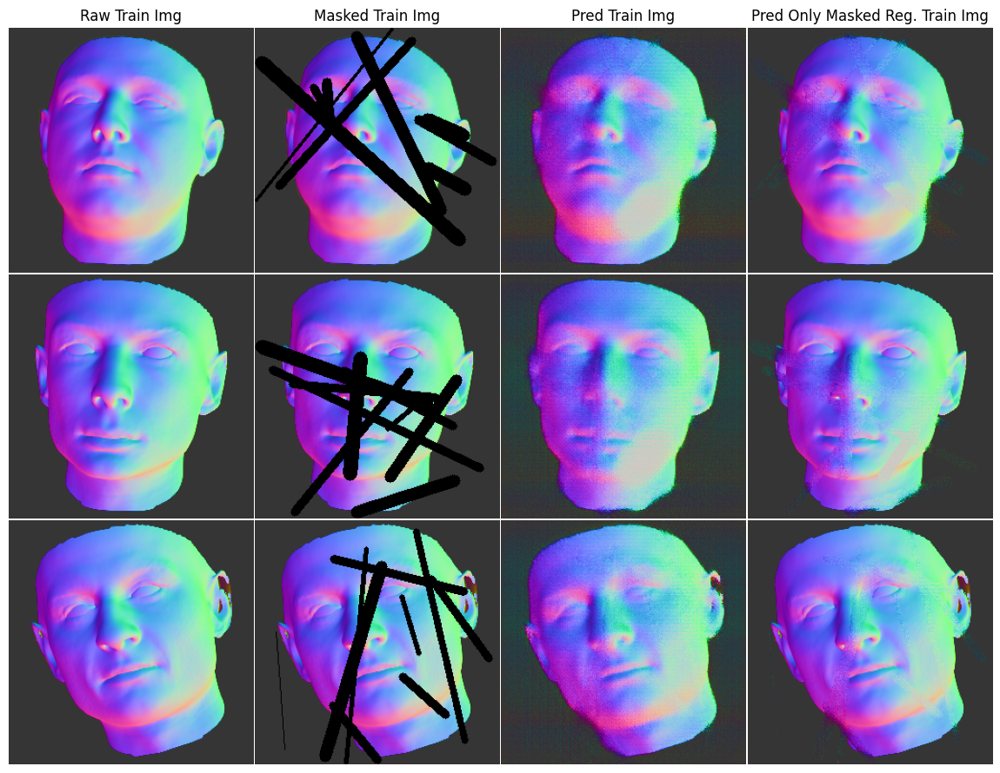

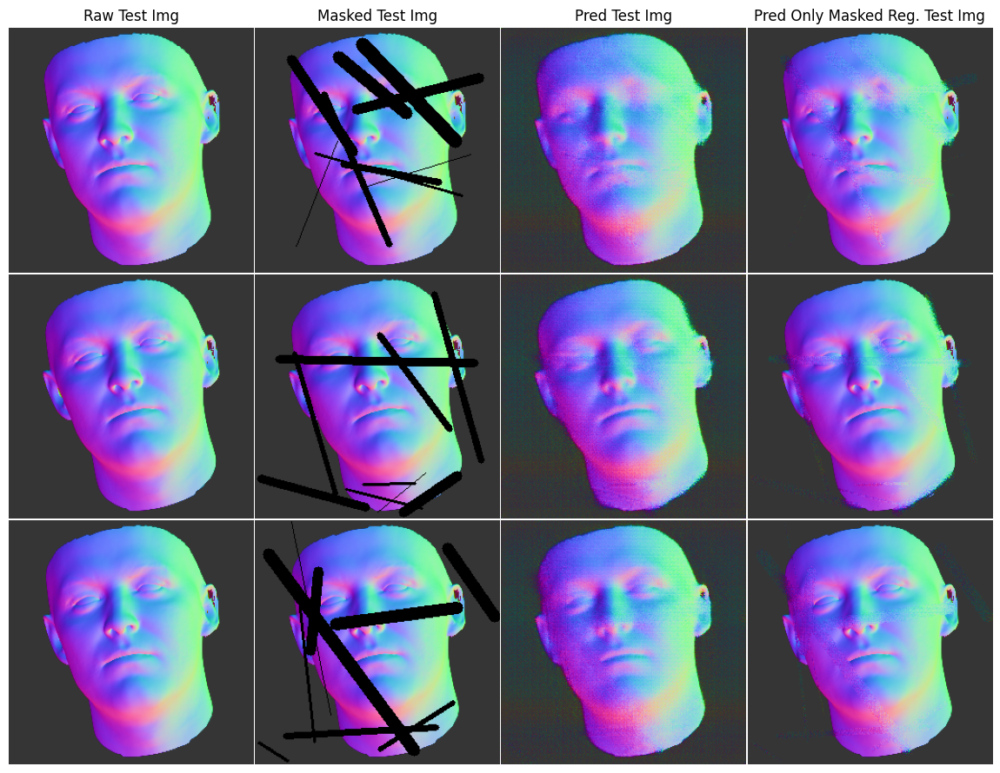

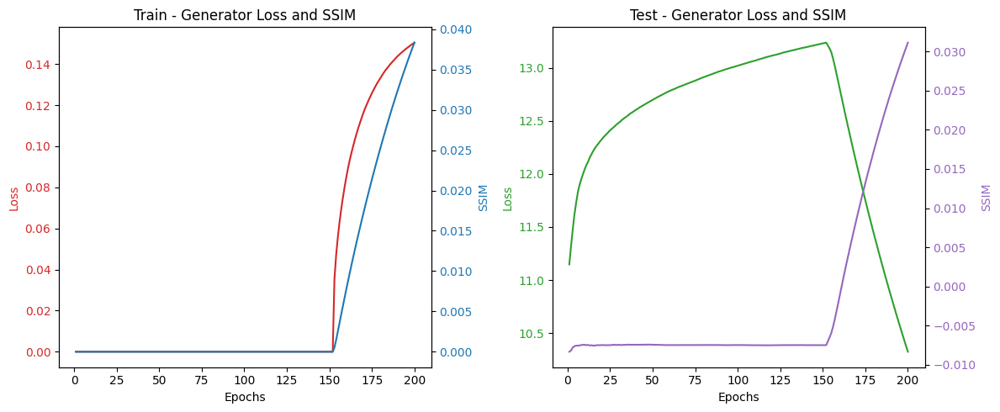

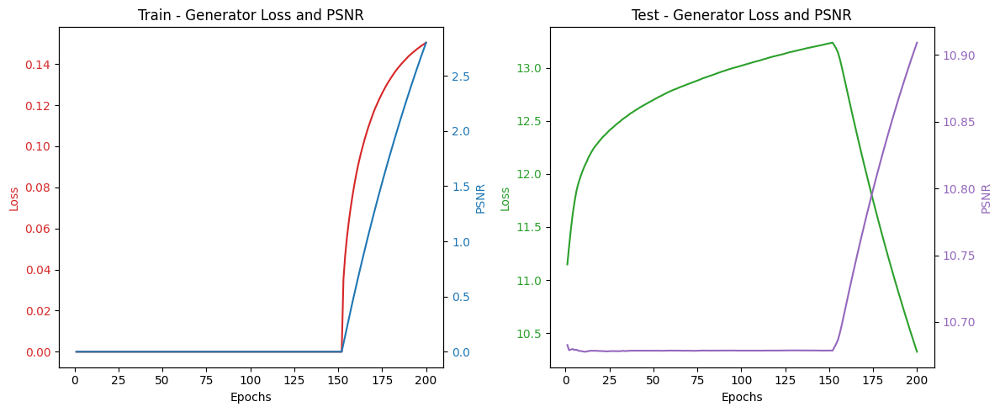

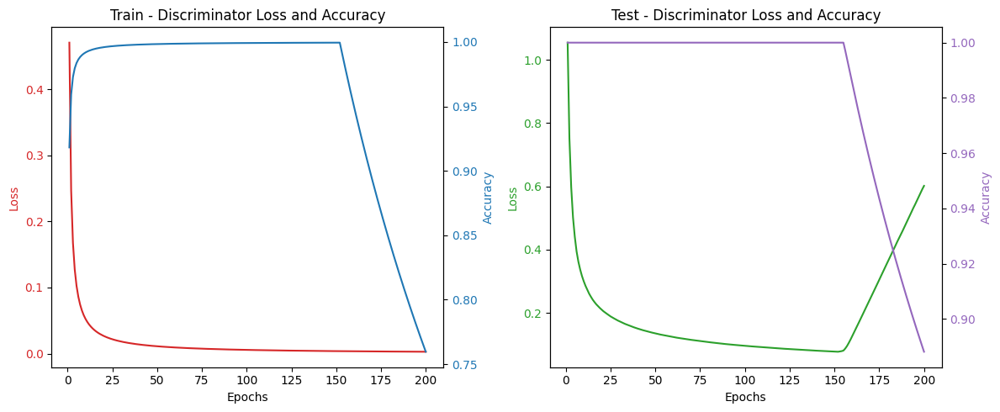

Epoch 201/2000  Train[G_Loss:0.24709 SSIM:15.11% PSNR:11.66 Disc:0.00000 0.000%]  Test[G_Loss:0.26048 SSIM:14.82% PSNR:11.66 Disc:2.96651 50.000%] - 6s - Training: Generator
Epoch 202/2000  Train[G_Loss:0.24449 SSIM:14.92% PSNR:11.66 Disc:0.00000 0.000%]  Test[G_Loss:0.25033 SSIM:15.00% PSNR:11.66 Disc:2.89928 50.000%] - 6s - Training: Generator
Epoch 203/2000  Train[G_Loss:0.24169 SSIM:14.92% PSNR:11.65 Disc:0.00000 0.000%]  Test[G_Loss:0.21991 SSIM:14.72% PSNR:11.65 Disc:3.00344 50.000%] - 6s - Training: Generator
Epoch 204/2000  Train[G_Loss:0.23609 SSIM:14.75% PSNR:11.65 Disc:0.00000 0.000%]  Test[G_Loss:0.21692 SSIM:14.74% PSNR:11.65 Disc:2.99810 50.000%] - 6s - Training: Generator
Epoch 205/2000  Train[G_Loss:0.23248 SSIM:14.75% PSNR:11.65 Disc:0.00000 0.000%]  Test[G_Loss:0.22942 SSIM:14.57% PSNR:11.65 Disc:3.00112 50.000%] - 6s - Training: Generator
Epoch 206/2000  Train[G_Loss:0.22106 SSIM:14.69% PSNR:11.65 Disc:0.00000 0.000%]  Test[G_Loss:0.21365 SSIM:14.64% PSNR:11.65 Disc:

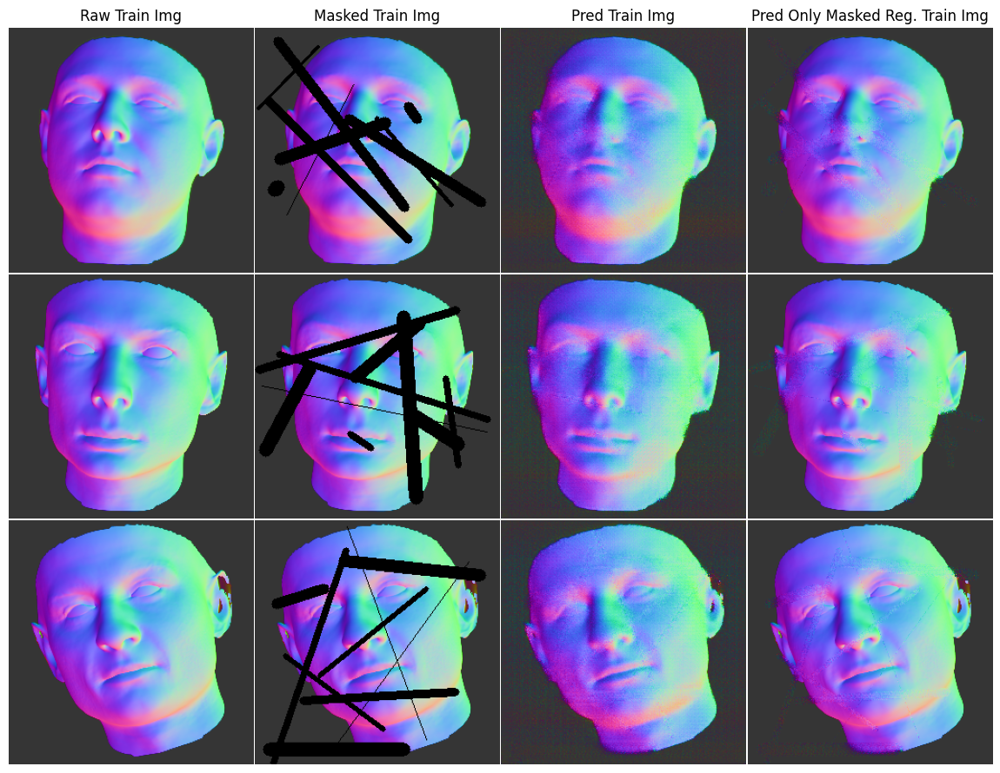

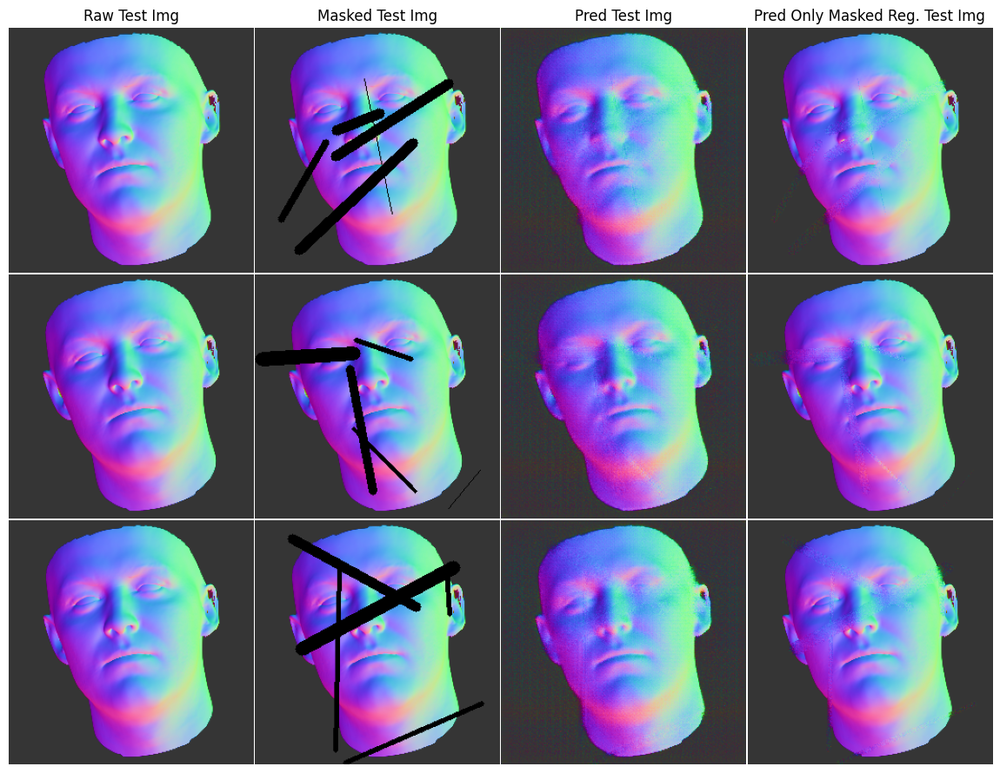

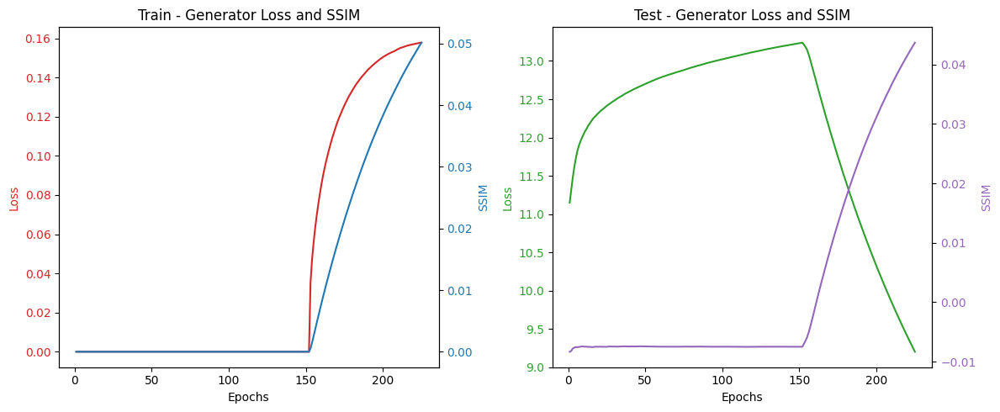

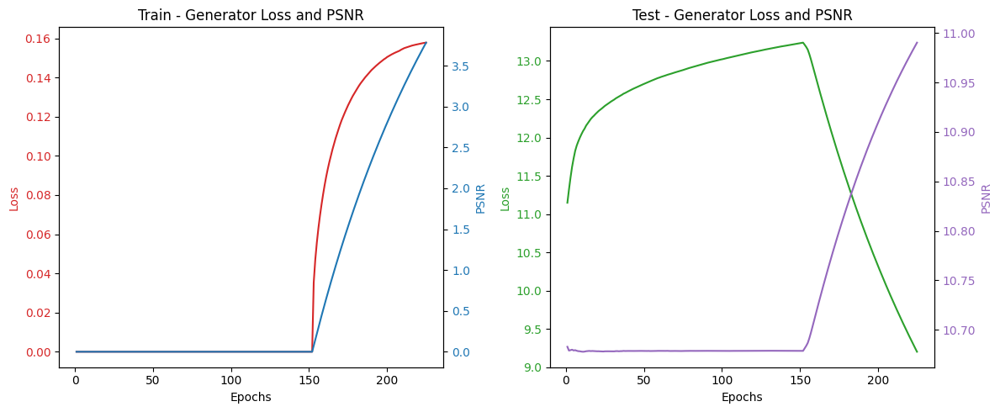

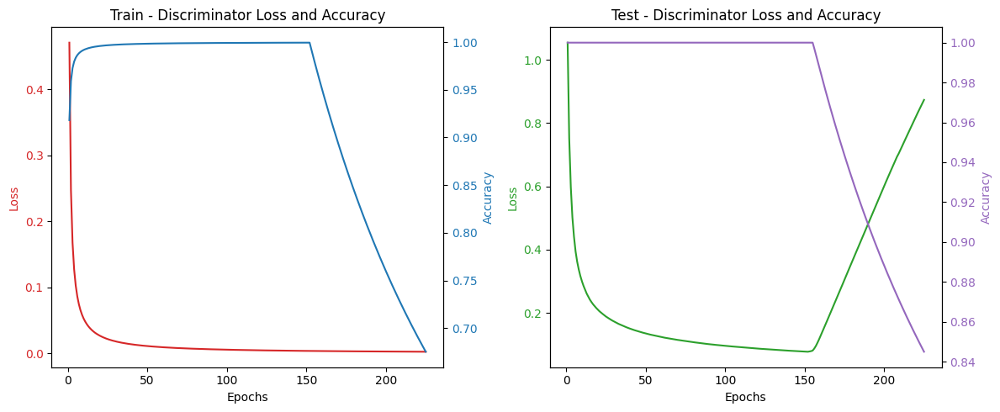

Epoch 226/2000  Train[G_Loss:0.18747 SSIM:14.03% PSNR:11.62 Disc:0.00000 0.000%]  Test[G_Loss:0.19291 SSIM:14.03% PSNR:11.63 Disc:3.15022 50.000%] - 6s - Training: Generator
Epoch 227/2000  Train[G_Loss:0.18439 SSIM:14.03% PSNR:11.62 Disc:0.00000 0.000%]  Test[G_Loss:0.24294 SSIM:13.86% PSNR:11.62 Disc:3.20792 50.000%] - 6s - Training: Generator
Epoch 228/2000  Train[G_Loss:0.18299 SSIM:13.95% PSNR:11.62 Disc:0.00000 0.000%]  Test[G_Loss:0.22362 SSIM:14.11% PSNR:11.63 Disc:3.08842 50.000%] - 6s - Training: Generator
Epoch 229/2000  Train[G_Loss:0.18129 SSIM:13.97% PSNR:11.62 Disc:0.00000 0.000%]  Test[G_Loss:0.21169 SSIM:13.88% PSNR:11.62 Disc:3.20705 50.000%] - 6s - Training: Generator
Epoch 230/2000  Train[G_Loss:0.18407 SSIM:13.96% PSNR:11.62 Disc:0.00000 0.000%]  Test[G_Loss:0.18449 SSIM:13.95% PSNR:11.62 Disc:3.18137 50.000%] - 6s - Training: Generator
Epoch 231/2000  Train[G_Loss:0.19244 SSIM:14.01% PSNR:11.62 Disc:0.00000 0.000%]  Test[G_Loss:0.18285 SSIM:13.79% PSNR:11.62 Disc:

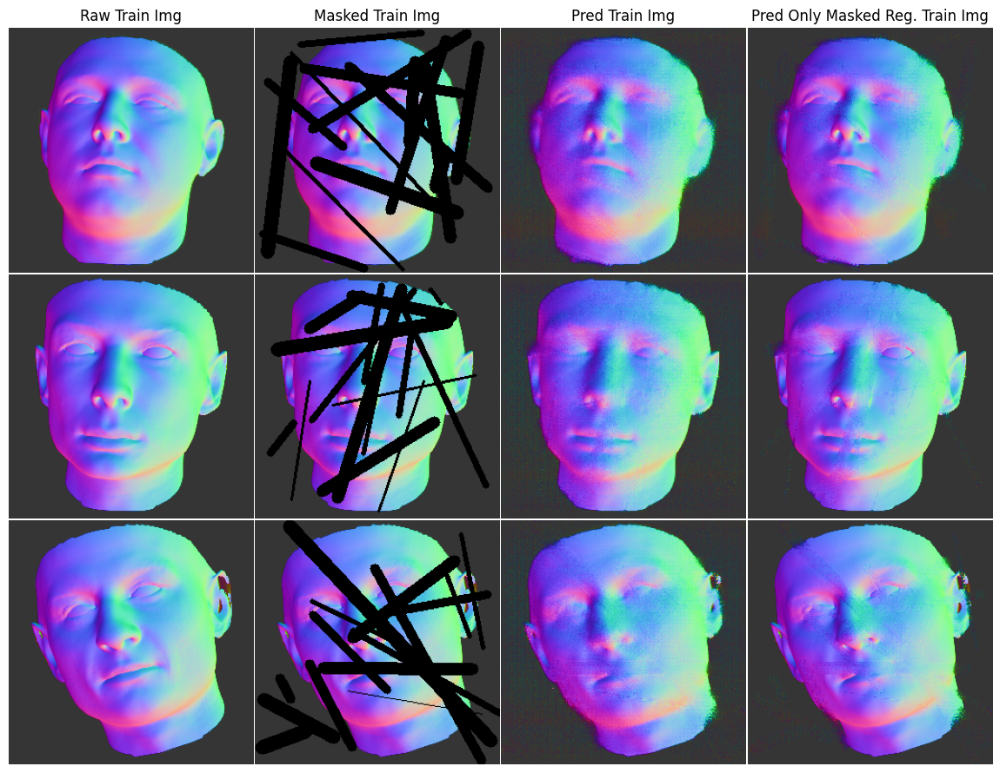

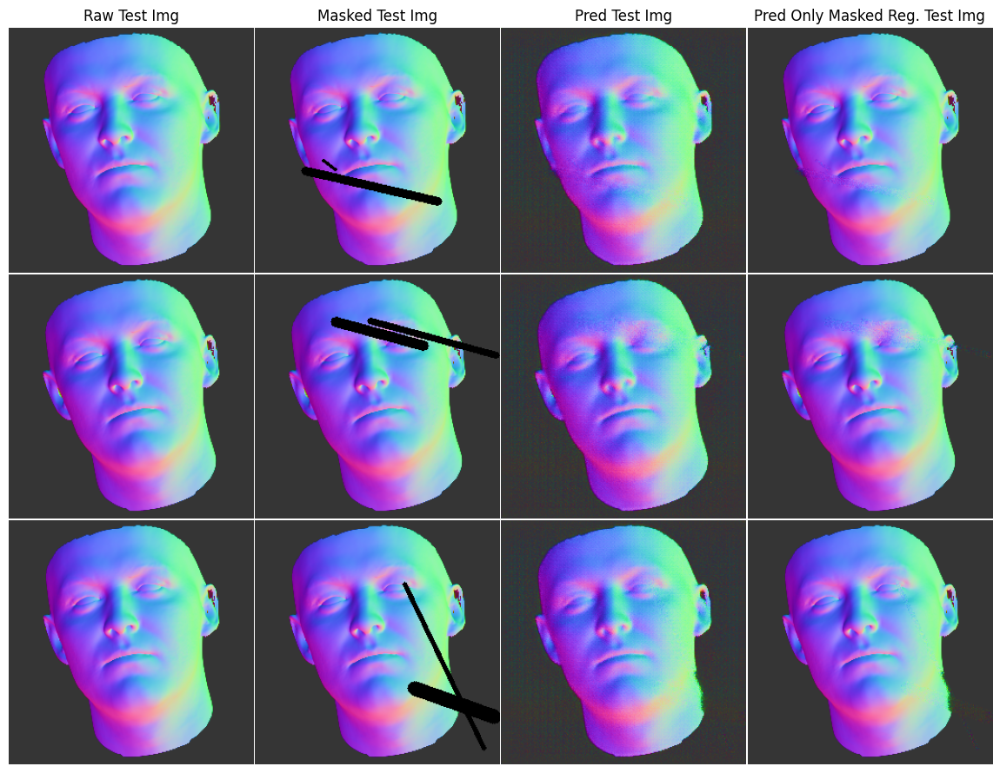

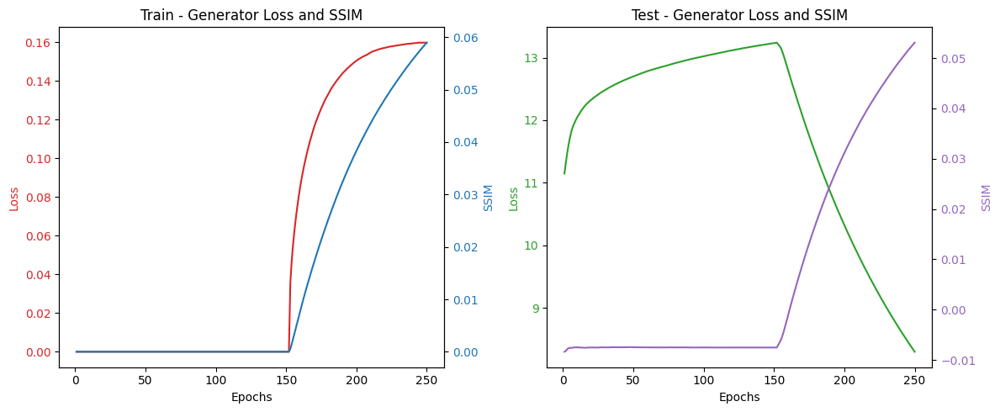

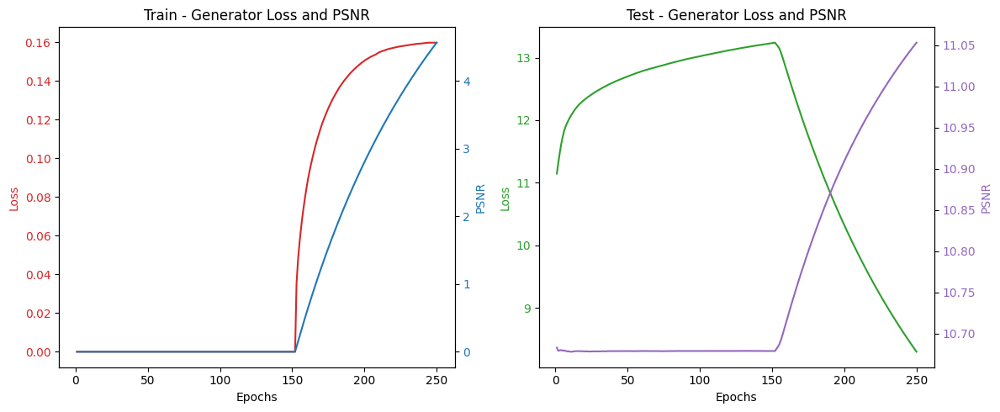

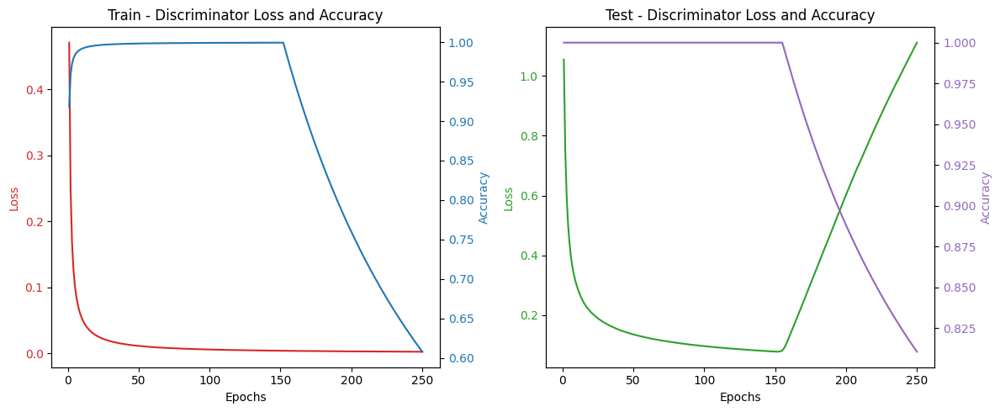

Epoch 251/2000  Train[G_Loss:0.15844 SSIM:13.53% PSNR:11.61 Disc:0.00000 0.000%]  Test[G_Loss:0.18747 SSIM:13.54% PSNR:11.61 Disc:3.29297 50.000%] - 6s - Training: Generator
Epoch 252/2000  Train[G_Loss:0.15967 SSIM:13.52% PSNR:11.61 Disc:0.00000 0.000%]  Test[G_Loss:0.16888 SSIM:13.16% PSNR:11.60 Disc:3.44893 50.000%] - 6s - Training: Generator
Epoch 253/2000  Train[G_Loss:0.15965 SSIM:13.50% PSNR:11.61 Disc:0.00000 0.000%]  Test[G_Loss:0.19402 SSIM:13.56% PSNR:11.61 Disc:3.27609 50.000%] - 6s - Training: Generator
Epoch 254/2000  Train[G_Loss:0.15218 SSIM:13.50% PSNR:11.61 Disc:0.00000 0.000%]  Test[G_Loss:0.18349 SSIM:13.18% PSNR:11.60 Disc:3.43943 50.000%] - 6s - Training: Generator
Epoch 255/2000  Train[G_Loss:0.16307 SSIM:13.46% PSNR:11.60 Disc:0.00000 0.000%]  Test[G_Loss:0.17305 SSIM:13.61% PSNR:11.61 Disc:3.27102 50.000%] - 6s - Training: Generator
Epoch 256/2000  Train[G_Loss:0.15594 SSIM:13.48% PSNR:11.61 Disc:0.00000 0.000%]  Test[G_Loss:0.15055 SSIM:13.04% PSNR:11.60 Disc:

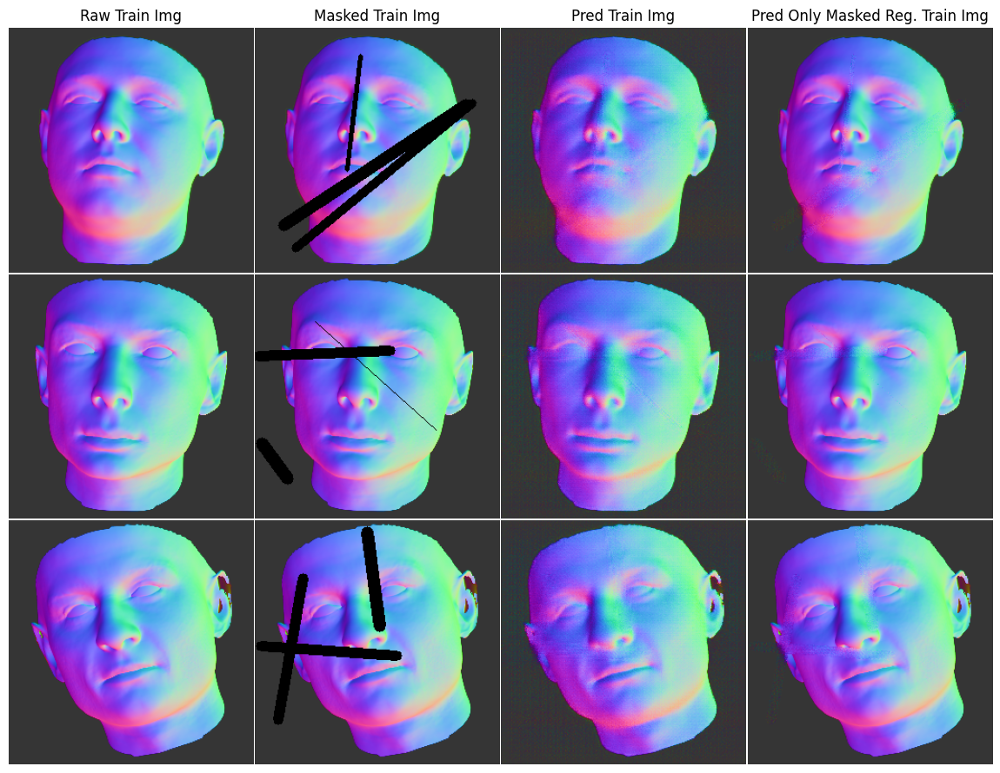

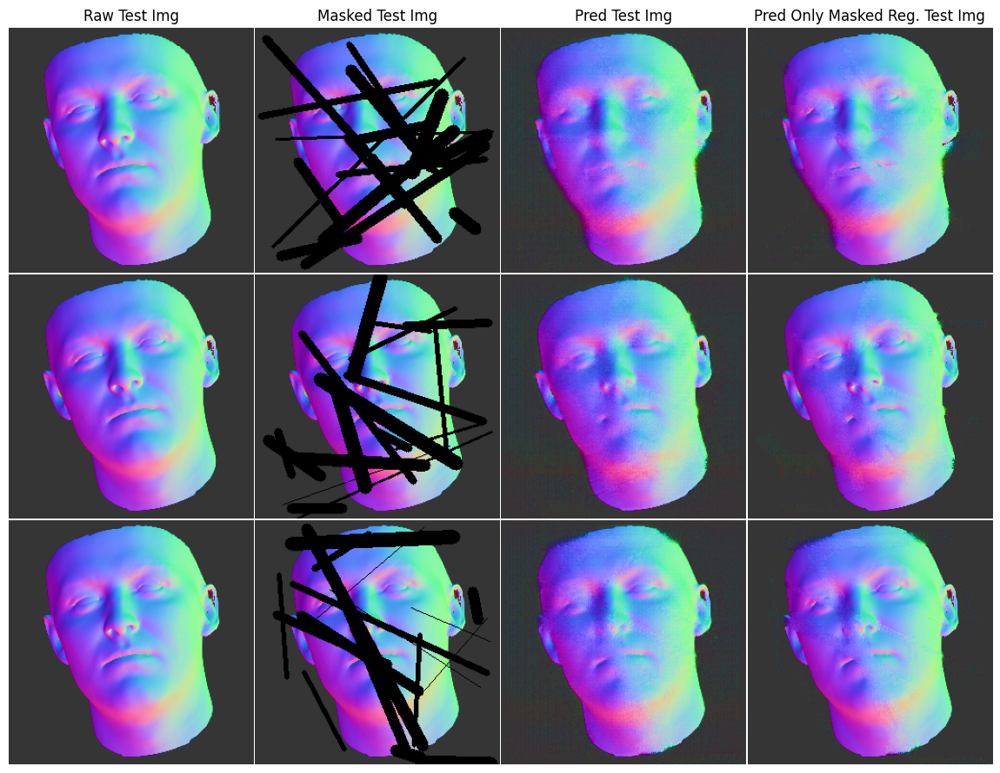

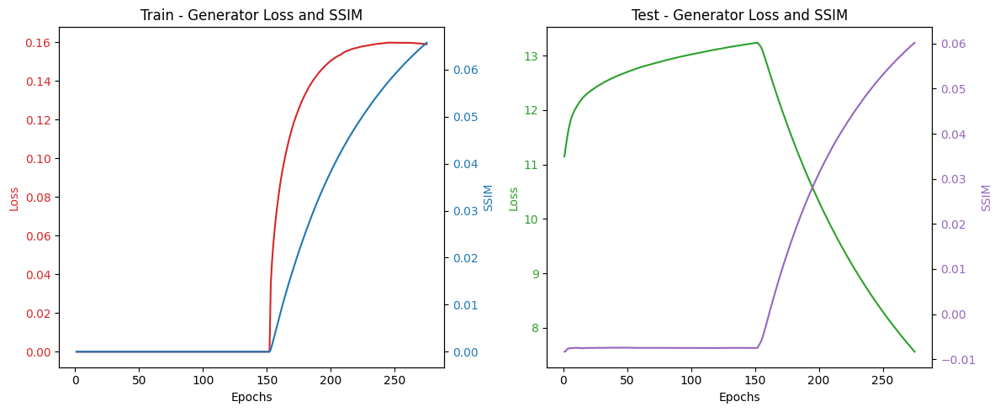

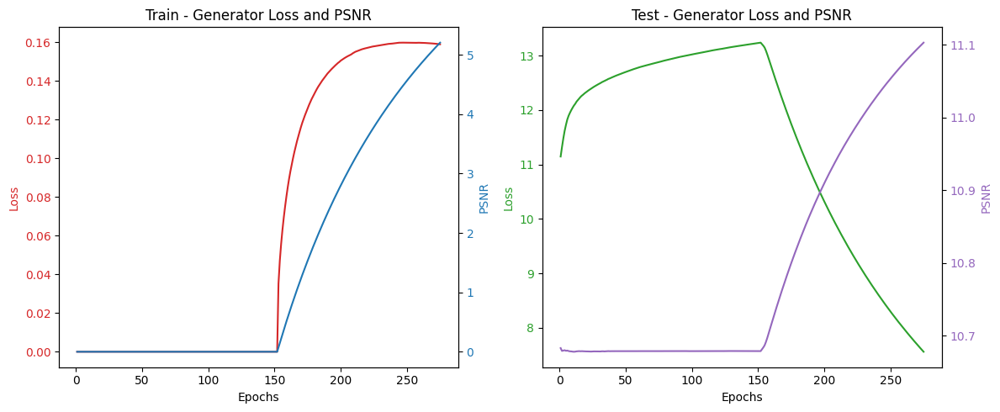

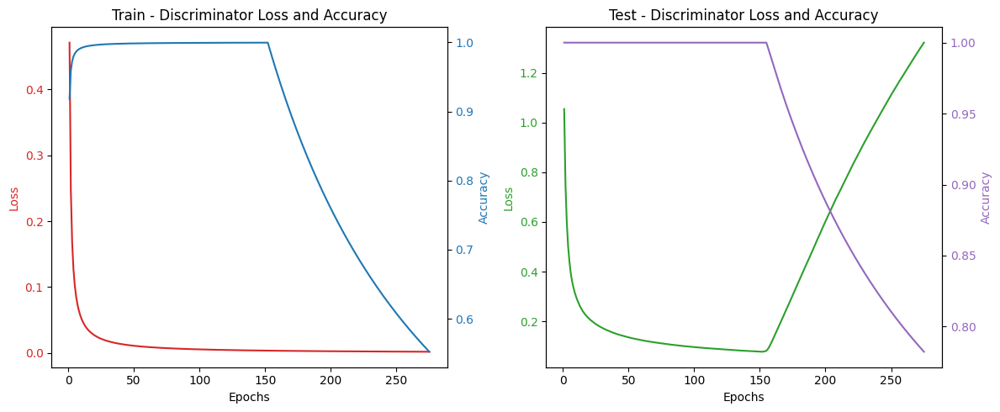

Epoch 276/2000  Train[G_Loss:0.13640 SSIM:13.07% PSNR:11.59 Disc:0.00000 0.000%]  Test[G_Loss:0.15545 SSIM:12.96% PSNR:11.59 Disc:3.48080 50.000%] - 6s - Training: Generator
Epoch 277/2000  Train[G_Loss:0.13068 SSIM:13.00% PSNR:11.59 Disc:0.00000 0.000%]  Test[G_Loss:0.14837 SSIM:12.87% PSNR:11.59 Disc:3.53394 50.000%] - 6s - Training: Generator
Epoch 278/2000  Train[G_Loss:0.13330 SSIM:13.07% PSNR:11.59 Disc:0.00000 0.000%]  Test[G_Loss:0.15326 SSIM:12.93% PSNR:11.59 Disc:3.48891 50.000%] - 6s - Training: Generator
Epoch 279/2000  Train[G_Loss:0.13289 SSIM:13.03% PSNR:11.59 Disc:0.00000 0.000%]  Test[G_Loss:0.14106 SSIM:12.92% PSNR:11.59 Disc:3.52148 50.000%] - 6s - Training: Generator
Epoch 280/2000  Train[G_Loss:0.13307 SSIM:13.05% PSNR:11.59 Disc:0.00000 0.000%]  Test[G_Loss:0.17540 SSIM:12.98% PSNR:11.59 Disc:3.47828 50.000%] - 6s - Training: Generator
Epoch 281/2000  Train[G_Loss:0.13670 SSIM:12.99% PSNR:11.59 Disc:0.00000 0.000%]  Test[G_Loss:0.15597 SSIM:12.99% PSNR:11.59 Disc:

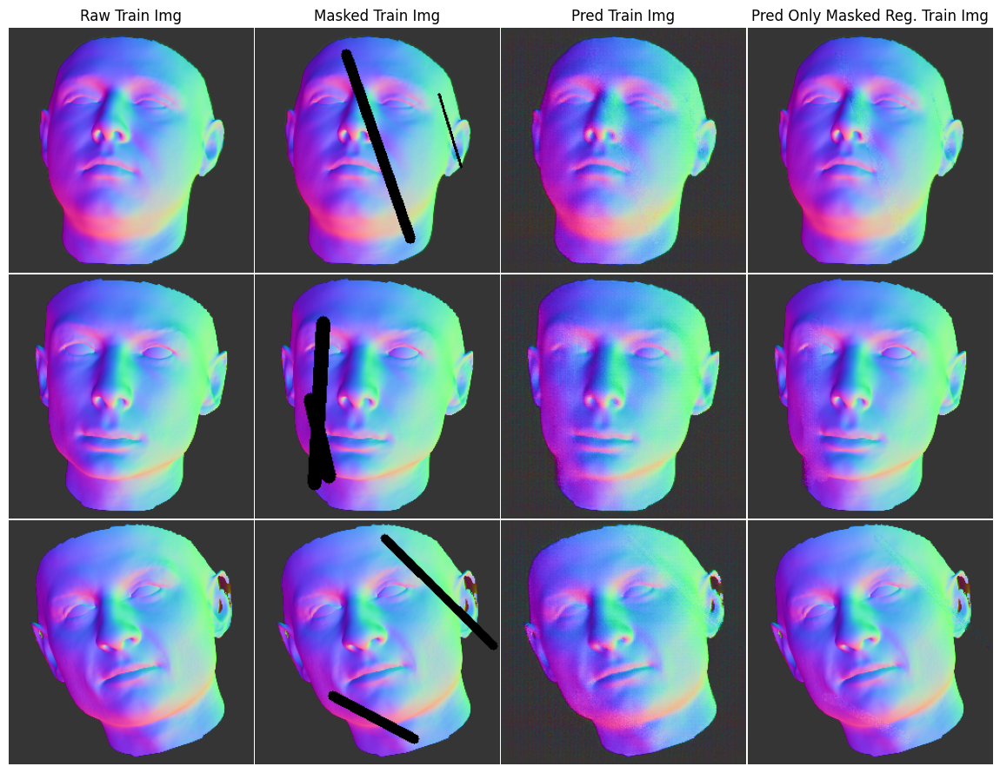

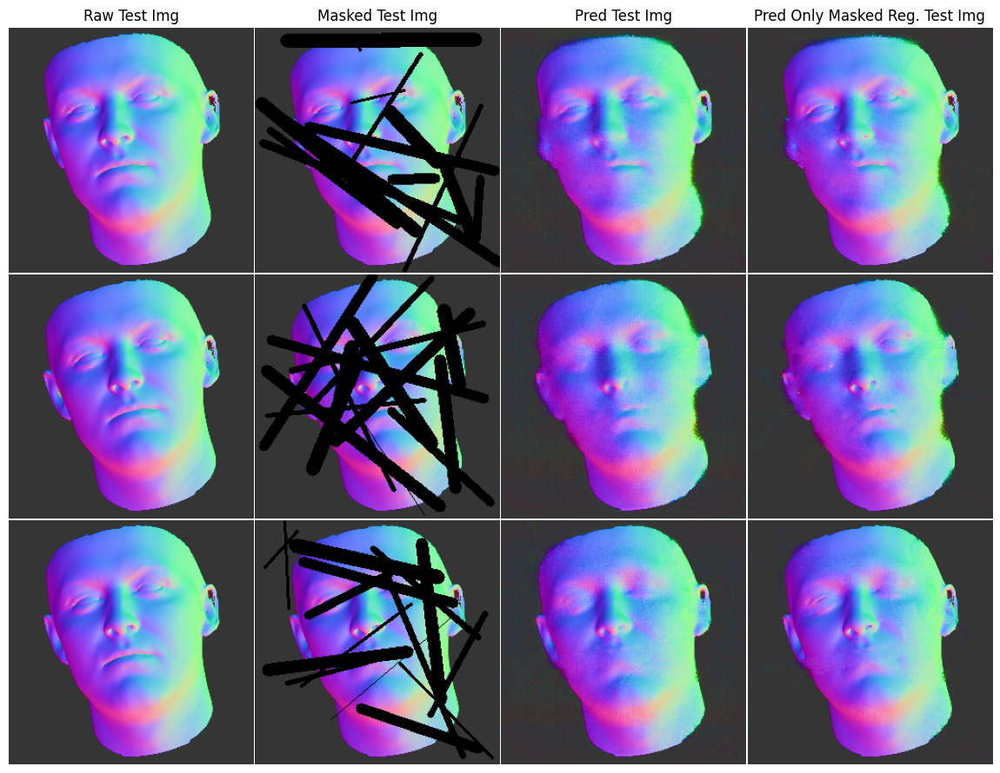

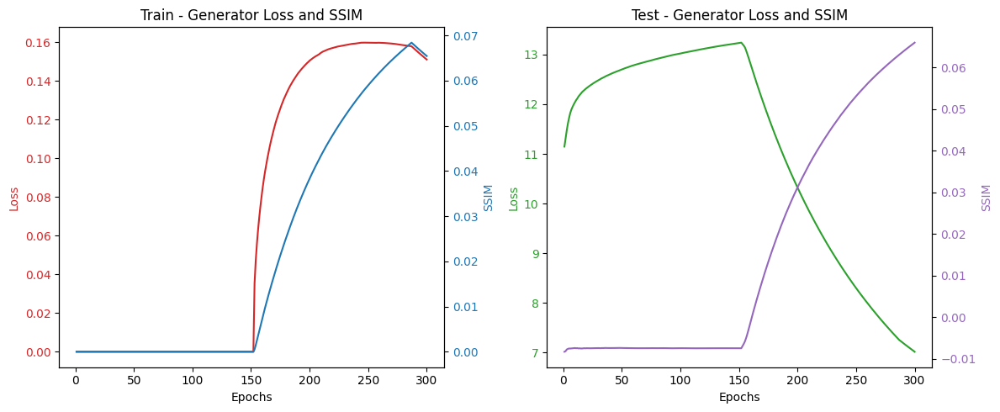

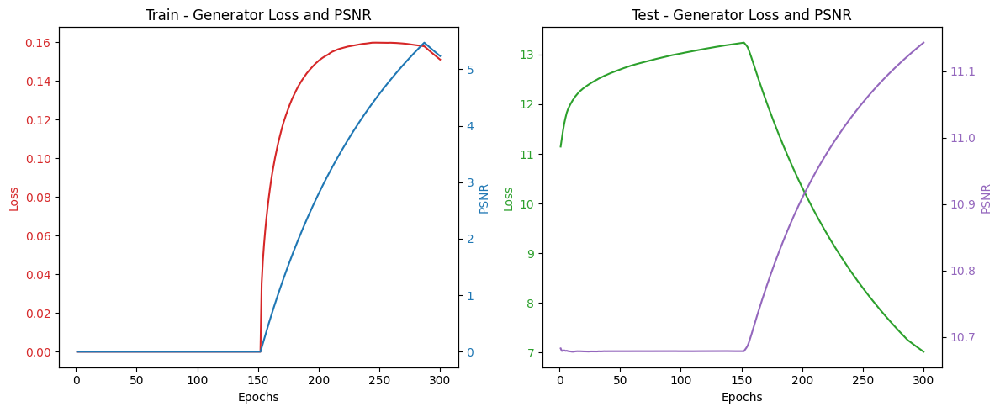

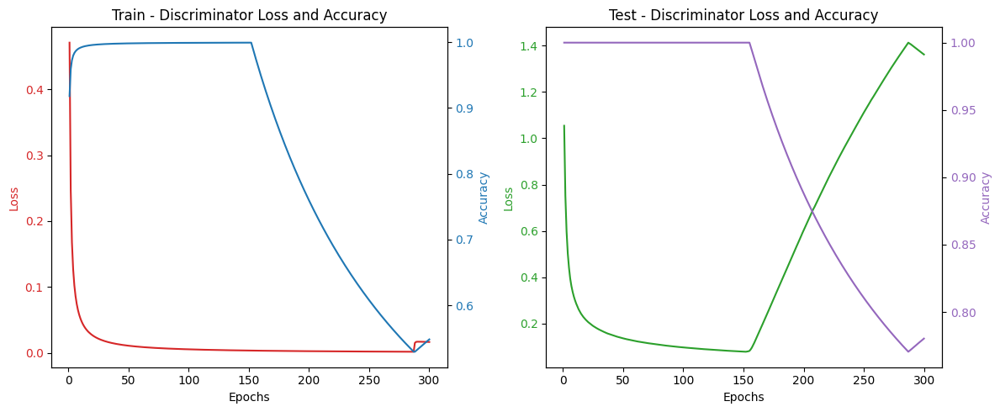

Epoch 301/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00177 100.000%]  Test[G_Loss:1.85696 SSIM:12.91% PSNR:11.59 Disc:0.19540 100.000%] - 3s - Training: Discriminator
Epoch 302/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00166 100.000%]  Test[G_Loss:1.85767 SSIM:12.90% PSNR:11.59 Disc:0.19418 100.000%] - 3s - Training: Discriminator
Epoch 303/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00157 100.000%]  Test[G_Loss:1.86339 SSIM:12.92% PSNR:11.59 Disc:0.19315 100.000%] - 3s - Training: Discriminator
Epoch 304/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00148 100.000%]  Test[G_Loss:1.87580 SSIM:12.90% PSNR:11.59 Disc:0.19229 100.000%] - 3s - Training: Discriminator
Epoch 305/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00141 100.000%]  Test[G_Loss:1.87682 SSIM:12.91% PSNR:11.59 Disc:0.19104 100.000%] - 3s - Training: Discriminator
Epoch 306/2000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00134 100.000%]  Test[G_Loss:1.87916 SSI

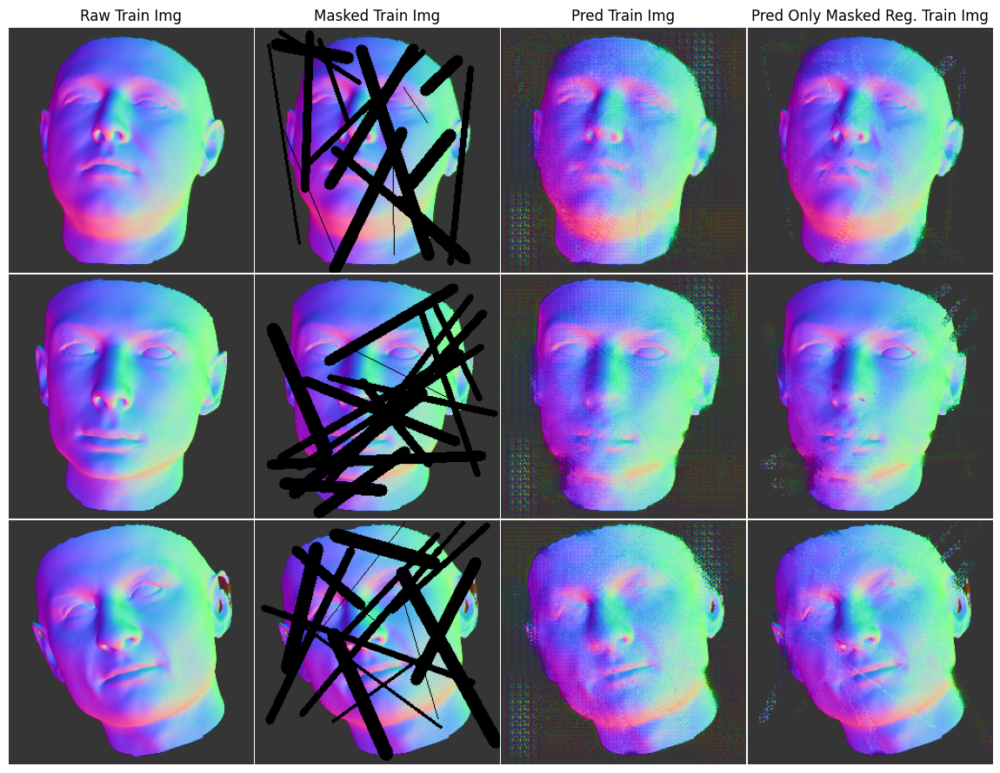

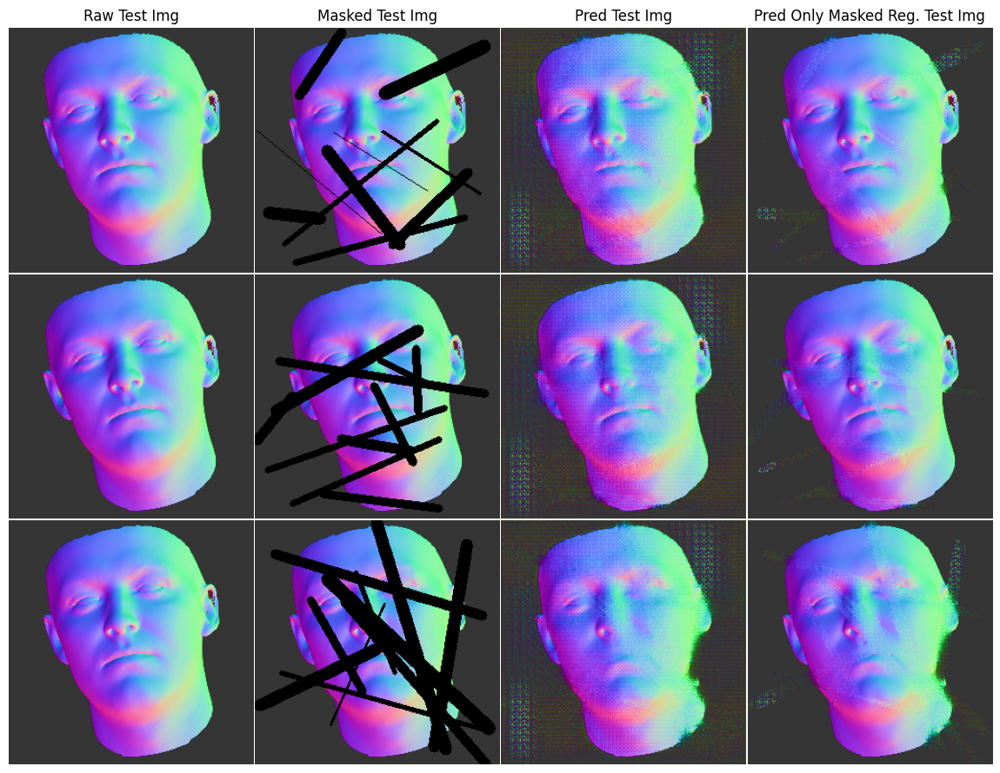

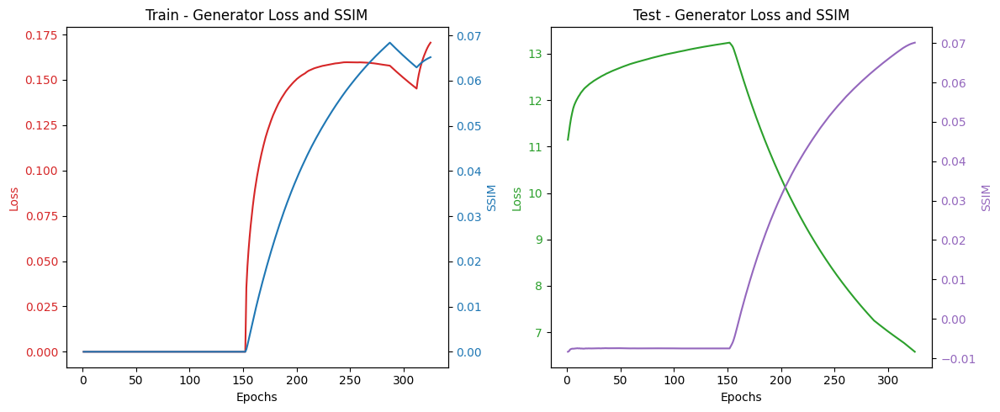

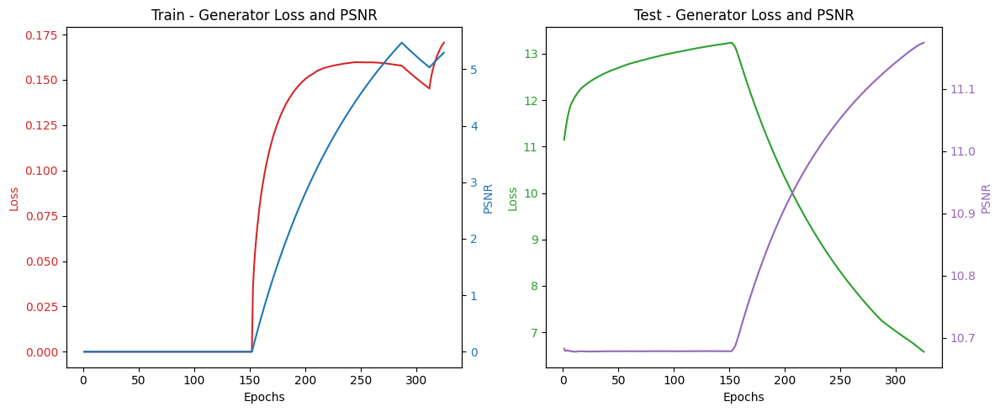

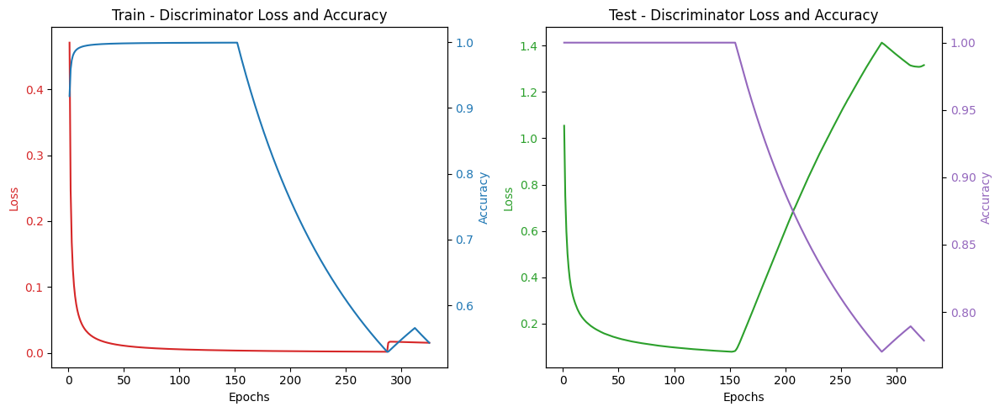

Epoch 326/2000  Train[G_Loss:0.40947 SSIM:9.97% PSNR:11.44 Disc:0.00000 0.000%]  Test[G_Loss:0.41182 SSIM:9.44% PSNR:11.41 Disc:2.20323 50.000%] - 6s - Training: Generator
Epoch 327/2000  Train[G_Loss:0.38596 SSIM:9.82% PSNR:11.42 Disc:0.00000 0.000%]  Test[G_Loss:0.38299 SSIM:9.46% PSNR:11.41 Disc:2.26522 50.000%] - 6s - Training: Generator
Epoch 328/2000  Train[G_Loss:0.35813 SSIM:9.67% PSNR:11.41 Disc:0.00000 0.000%]  Test[G_Loss:0.71498 SSIM:9.65% PSNR:11.41 Disc:1.94176 50.000%] - 6s - Training: Generator
Epoch 329/2000  Train[G_Loss:0.34325 SSIM:9.50% PSNR:11.40 Disc:0.00000 0.000%]  Test[G_Loss:0.45559 SSIM:9.38% PSNR:11.40 Disc:2.20791 50.000%] - 6s - Training: Generator
Epoch 330/2000  Train[G_Loss:0.33760 SSIM:9.42% PSNR:11.40 Disc:0.00000 0.000%]  Test[G_Loss:0.40657 SSIM:9.40% PSNR:11.40 Disc:2.40350 50.000%] - 6s - Training: Generator
Epoch 331/2000  Train[G_Loss:0.33610 SSIM:9.43% PSNR:11.40 Disc:0.00000 0.000%]  Test[G_Loss:0.33694 SSIM:9.33% PSNR:11.40 Disc:2.37534 50.0

In [42]:
model_path = './saved_model/generator.h5'
if not os.path.exists(model_path):
    train(train_dataset, max_epochs = 2000, epoch_break = 25, batches_list_num = 15, early_stopping_rounds = 25)
    generator.save('./saved_model/generator.h5')

# Testing and Evaluation on Test Dataset

### Load trained generator

In [43]:
gen_model_pth = './saved_models/generator.h5'
if os.path.exists(gen_model_pth):
    print('Load generator model')
    generator = load_model(gen_model_pth, custom_objects={'UnitNormalize': UnitNormalize})

In [44]:
test_metrics = assessment(test_dataset)

print("Test dataset Avg LOSS: {:.2f}\n"
      "Test dataset Avg SSIM: {:.2f}%\n"
      "Test dataset Avg PSNR: {:.2f}\n"
      "Test dataset Disc Avg Loss: {:.2f}\n"
      "Test dataset Disc Avg ACC: {:.2f}%".format(test_metrics['gen_loss'], 
                                                  test_metrics['gen_ssim'] * 100, 
                                                  test_metrics['gen_psnr'], 
                                                  test_metrics['disc_loss'], 
                                                  test_metrics['disc_acc'] * 100))

Test dataset Avg LOSS: 0.29
Test dataset Avg SSIM: 8.95%
Test dataset Avg PSNR: 11.38
Test dataset Disc Avg Loss: 2.57
Test dataset Disc Avg ACC: 50.00%


In [45]:
print('Pred time for a batch')
for images_batch in test_dataset.take(1):
    test_raw_images = images_batch
    test_mask_channels = mask_irregular(test_raw_images.shape[0], test_raw_images.shape[1], test_raw_images.shape[2])
    test_masked_images = masked_imgs(test_raw_images, test_mask_channels)
    test_pred_images = generator.predict([test_masked_images, test_mask_channels], batch_size=BATCH_SIZE)

Pred time for a batch
1/1 [==============================] - 0s 324ms/step


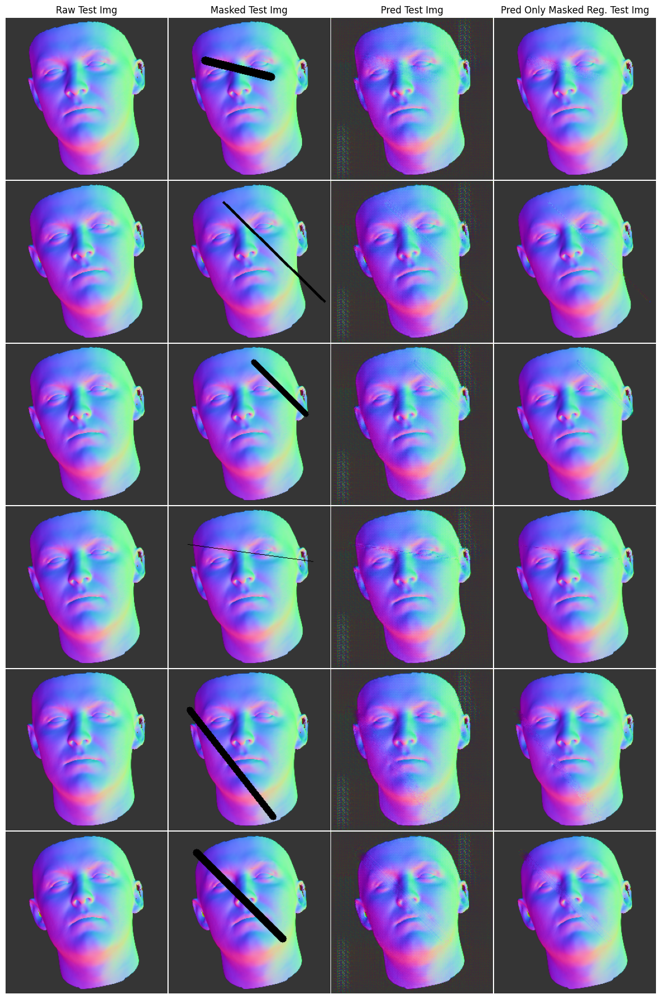

In [46]:
generator_plot_images(generator, 'Test', test_dataset, num = 6)

### Reading and plotting data from log data file

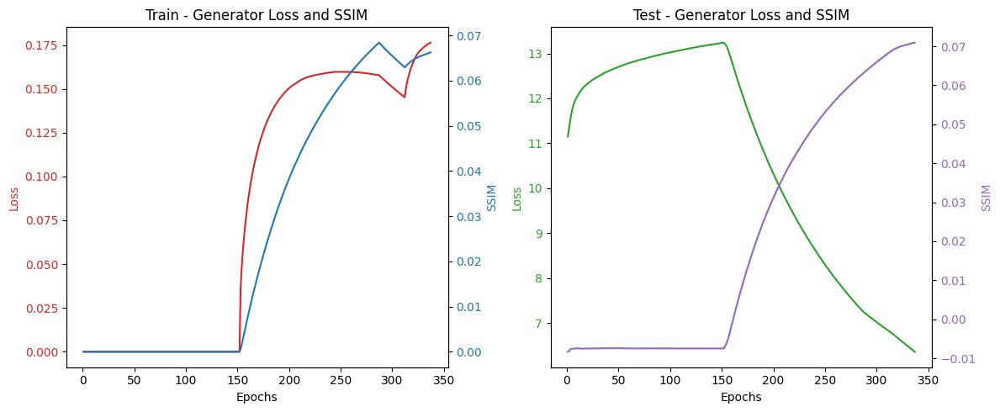

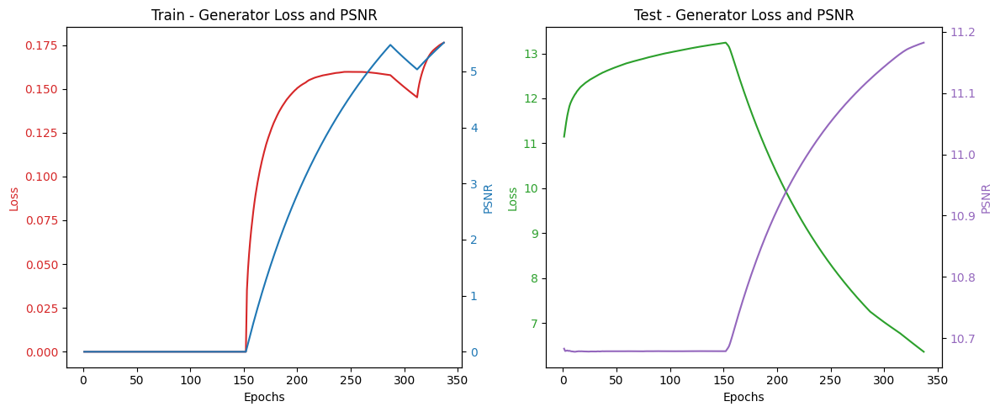

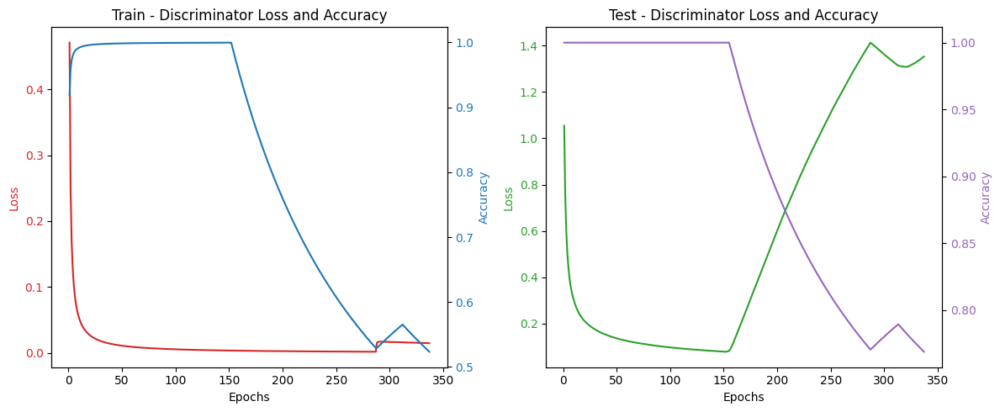

In [47]:
log_dir = './saved_logs'
os.makedirs(log_dir, exist_ok=True)
log_file = os.path.join(log_dir, "GAN_training_results.csv")
plot_metrics(load_metrics_from_csv(log_file))